##  GR DUSP1 Gating Notebook

The Purpose of this notebook is:
1) Load in all analyisis for final dataframe preparation 
2) Filter DUSP1 data to remove partial cells and low SNR spots
3) Filter GR data to remove partial cells
4) Estimate GR cytoplasmic area from DUPS1 data
5) GR intensity to molecular counts 
6) Concatonate final GR and DUSP1 dataframes

In [16]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import dask.array as da
import os
import sys
import logging
import seaborn as sns

logging.getLogger('matplotlib.font_manager').disabled = True
numba_logger = logging.getLogger('numba')
numba_logger.setLevel(logging.WARNING)

matplotlib_logger = logging.getLogger('matplotlib')
matplotlib_logger.setLevel(logging.WARNING)

src_path = os.path.abspath(os.path.join(os.getcwd(), '..', '..'))
print(src_path)
sys.path.append(src_path)

from src.Analysis import AnalysisManager, Analysis, SpotDetection_SNRConfirmation, Spot_Cluster_Analysis_WeightedSNR, GR_Confirmation

/Users/ericron/Desktop/AngelFISH


In [17]:
loc = None 
log_location = r'/Volumes/share/Users/Eric/GR_DUSP1_reruns' # r'/Volumes/share/Users/Jack/All_Analysis' 

In [18]:
# Measure function to create final DUSP1 dataframe for SSIT
# Function to get the second largest value or default to 0
def second_largest(series):
    unique_vals = series.dropna().unique()  # Remove NaN and get unique values
    if len(unique_vals) < 2:
        return 0  # Return 0 if there's no second-largest value
    return np.sort(unique_vals)[-2]  # Return the second-largest value

def touching_border(df, image_height, image_width):
    """
    Returns a boolean Series indicating which cells are
    touching any image border (no margin).

    Expects df to have columns:
      'cell_bbox-0' => min_row
      'cell_bbox-1' => min_col
      'cell_bbox-2' => max_row (exclusive)
      'cell_bbox-3' => max_col (exclusive).
    """
    min_row = df['cell_bbox-0']
    min_col = df['cell_bbox-1']
    max_row = df['cell_bbox-2']
    max_col = df['cell_bbox-3']

    return (
        (min_row == 0) 
        | (min_col == 0) 
        | (max_row == image_height) 
        | (max_col == image_width)
    )

def filter_DUSP1(name, is_tpl=False):
    # Initiate the class and find analysis at log_location
    am = AnalysisManager(location=loc, log_location=log_location, mac=True)
    # Select the dataset
    am.select_analysis(name)
    # Initiate the Weighted SNR analysis class
    SD = Spot_Cluster_Analysis_WeightedSNR(am)
    # Load the data
    SD.get_data()
    # Obtain image height/width from [p,c,t,z,y,x]
    image0 = SD.images[0]  # The first image in the list
    image_height, image_width = image0.shape[-2], image0.shape[-1]
    print(f"Image shape: {image0.shape} => height={image_height}, width={image_width}")
    print(f"Total number of cells before filtering: {SD.cellprops.shape[0]}")
    print(f"Total number of spots before filtering: {SD.spots.shape[0]}")
    # Assign revised weighted threshold
    snr_cutoff_2_5 = SD.assign_revised_weighted_threshold()
    print(f"The revised weighted threshold is: {snr_cutoff_2_5}")
    # Create unique cell id for every cell
    SD.cellprops['unique_cell_id'] = np.arange(len(SD.cellprops))
    # Remove partial cells from dataset (no margin)
    SD.cellprops['touching_border'] = touching_border(
        SD.cellprops, 
        image_height=image_height, 
        image_width=image_width
    )
    # Keep only cells that are NOT touching the border
    SD.cellprops = SD.cellprops[~SD.cellprops['touching_border']]
    # Remove spots that are less than the weighted snr threshold
    SD.spots = SD.spots[SD.spots['keep_wsnr']]
    # Merge the spots and clusters dataframes by the unique cell ID
    SD.spots = SD.spots.merge(
        SD.cellprops[['NAS_location', 'cell_label', 'fov', 'unique_cell_id']], 
        on=['NAS_location', 'cell_label', 'fov'], 
        how='left'
    )
    SD.clusters = SD.clusters.merge(
        SD.cellprops[['NAS_location', 'cell_label', 'fov', 'unique_cell_id']], 
        on=['NAS_location', 'cell_label', 'fov'], 
        how='left'
    )
    SD.display_gating_plus_display()
    am.close()

    # Use measure_DUSP1 to create SSIT compatible dataframe
    if not is_tpl:
        results = measure_DUSP1(SD.spots, SD.clusters, SD.cellprops)
    else:
        results = measure_DUSP1_TPL(SD.spots, SD.clusters, SD.cellprops)

    print(f"Total number of cells after filtering: {results.shape[0]}")
    print(f"Total number of spots counted: {np.sum(results['num_spots'])}")
    return results


def filter_GR(name):
    # Initiate the class and find analysis at log_location
    am = AnalysisManager(location=loc, log_location=log_location, mac=True)
    # Select the dataset
    am.select_analysis(name)
    # select GR conformation analysis 
    GR = GR_Confirmation(am)
    # Load the data
    GR.get_data()
    # Obtain image height/width from [p,c,t,z,y,x]
    image0 = GR.images[0]  # The first image in the list
    image_height, image_width = image0.shape[-2], image0.shape[-1]
    print(f"Image shape: {image0.shape} => height={image_height}, width={image_width}")
    # Create unique cell id for every cell
    GR.cellprops['unique_cell_id'] = np.arange(len(GR.cellprops))
    # Remove partial cells (i.e. those that touch any image border)
    GR.cellprops['touching_border'] = touching_border(
        GR.cellprops, 
        image_height=image_height, 
        image_width=image_width
    )
    GR.cellprops = GR.cellprops[~GR.cellprops['touching_border']]
    am.close()
    # Use measure_GR to create SSIT-compatible dataframe
    return measure_GR(GR.cellprops)

def measure_DUSP1(spots, clusters, props) -> pd.DataFrame:
    results = pd.DataFrame(columns=['cell_id', 'num_ts', 'num_spots_ts', 'largest_ts', 'second_largest_ts', 'num_foci', 'num_spots_foci', 'num_spots', 'num_nuc_spots', 'num_cyto_spots', 
                                    'nuc_area_px', 'cyto_area_px', 'avg_nuc_int', 'avg_cyto_int', 'time', 'dex_conc', 'replica', 'fov', 'nas_location', ])
    
    # Sort spots, clusters, and props by unique_cell_id
    spots = spots.sort_values(by='unique_cell_id')
    clusters = clusters.sort_values(by='unique_cell_id')
    props = props.sort_values(by='unique_cell_id')

    # unique cell id
    cell_ids = props['unique_cell_id']
    # num of ts
    num_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of foci
    num_foci = clusters[clusters['is_nuc'] == 0].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of ts spots
    num_spots_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].sum().reindex(cell_ids, fill_value=0)
    # largest TS size
    largest_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].max().reindex(cell_ids, fill_value=0)
    # Compute second-largest TS size per cell
    second_largest_ts = (clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].apply(second_largest).reindex(cell_ids, fill_value=0))    
    # num of foci spots
    num_spots_foci = clusters[clusters['is_nuc'] == 0].groupby('unique_cell_id')['nb_spots'].sum().reindex(cell_ids, fill_value=0)
    # num of spots
    num_spots = spots.groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of spot in nuc
    num_nuc_spots = spots[spots['is_nuc'] == 1].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of spot in cyto 
    num_cyto_spots = spots[spots['is_nuc'] == 0].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # nuc area
    nuc_area = props['nuc_area']
    # cyto area
    cyto_area = props['cyto_area']
    # avg int nuc
    avg_nuc_int = props['nuc_intensity_mean-0']
    # avg int cyto
    avg_cyto_int = props['cyto_intensity_mean-0']
    # time (experiment)
    time = props['time'] 
    # Dex conc
    dex_conc = props['Dex_Conc']
    # Replica
    replica = spots.groupby('unique_cell_id')['replica'].first().reindex(cell_ids, fill_value=np.nan)

    results['cell_id'] = cell_ids
    results['num_ts'] = num_ts.values
    results['largest_ts'] = largest_ts.values
    results['second_largest_ts'] = second_largest_ts.values
    results['num_foci'] = num_foci.values
    results['num_spots_ts'] = num_spots_ts.values
    results['num_spots_foci'] = num_spots_foci.values
    results['num_spots'] = num_spots.values
    results['num_nuc_spots'] = num_nuc_spots.values
    results['num_cyto_spots'] = num_cyto_spots.values
    results['nuc_area_px'] = nuc_area.values
    results['cyto_area_px'] = cyto_area.values
    results['avg_nuc_int'] = avg_nuc_int.values
    results['avg_cyto_int'] = avg_cyto_int.values
    results['time'] = time.values
    results['dex_conc'] = dex_conc.values
    results['replica'] = replica.values

    return results

def measure_DUSP1_TPL(spots, clusters, props) -> pd.DataFrame:
    results = pd.DataFrame(columns=['cell_id', 'num_ts', 'num_spots_ts', 'largest_ts', 'second_largest_ts', 'num_foci', 'num_spots_foci', 'num_spots', 'num_nuc_spots', 'num_cyto_spots', 
                                    'nuc_area_px', 'cyto_area_px', 'avg_nuc_int', 'avg_cyto_int', 'time', 'time_tpl' 'dex_conc', 'replica',
                                    'tryptCond1', 'tryptCond2', 'tryptCond3', 'tryptCond4', 'tryptCond5'])
    
    # Sort spots, clusters, and props by unique_cell_id
    spots = spots.sort_values(by='unique_cell_id')
    clusters = clusters.sort_values(by='unique_cell_id')
    props = props.sort_values(by='unique_cell_id')

    # unique cell id
    cell_ids = props['unique_cell_id']
    # num of ts
    num_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of foci
    num_foci = clusters[clusters['is_nuc'] == 0].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of ts spots
    num_spots_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].sum().reindex(cell_ids, fill_value=0)
    # largest TS size
    largest_ts = clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].max().reindex(cell_ids, fill_value=0)
    # Compute second-largest TS size per cell
    second_largest_ts = (clusters[clusters['is_nuc'] == 1].groupby('unique_cell_id')['nb_spots'].apply(second_largest).reindex(cell_ids, fill_value=0))    
    # num of foci spots
    num_spots_foci = clusters[clusters['is_nuc'] == 0].groupby('unique_cell_id')['nb_spots'].sum().reindex(cell_ids, fill_value=0)
    # num of spots
    num_spots = spots.groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of spot in nuc
    num_nuc_spots = spots[spots['is_nuc'] == 1].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # num of spot in cyto 
    num_cyto_spots = spots[spots['is_nuc'] == 0].groupby('unique_cell_id').size().reindex(cell_ids, fill_value=0)
    # nuc area
    nuc_area = props['nuc_area']
    # cyto area
    cyto_area = props['cyto_area']
    # avg int nuc
    avg_nuc_int = props['nuc_intensity_mean-0']
    # avg int cyto
    avg_cyto_int = props['cyto_intensity_mean-0']
    # time of Dex(experiment)
    time = props['time'] 
    # time of tpl
    time_tpl = props['time_tpl']
    # Dex conc
    dex_conc = props['Dex_Conc']
    # Replica
    replica = spots.groupby('unique_cell_id')['replica'].first().reindex(cell_ids, fill_value=np.nan)
    # Extract unique TPL times
    trptTimes = np.sort(props['time_tpl'].dropna().unique())
    # Initialize tryptCond columns
    for k, t_TPL in enumerate(trptTimes, start=1):
        JJ = (
            ((dex_conc == 100) | (time == 0)) &
            ((time == 0) | ((time <= t_TPL) & time_tpl.isna()) | ((time >= t_TPL) & (time_tpl == t_TPL)))
        )
        results[f'tryptCond{k}'] = JJ.astype(int) * k
    
    # Populate DataFrame
    results['cell_id'] = cell_ids
    results['num_ts'] = num_ts.values
    results['largest_ts'] = largest_ts.values
    results['second_largest_ts'] = second_largest_ts.values
    results['num_foci'] = num_foci.values
    results['num_spots_ts'] = num_spots_ts.values
    results['num_spots_foci'] = num_spots_foci.values
    results['num_spots'] = num_spots.values
    results['num_nuc_spots'] = num_nuc_spots.values
    results['num_cyto_spots'] = num_cyto_spots.values
    results['nuc_area_px'] = nuc_area.values
    results['cyto_area_px'] = cyto_area.values
    results['avg_nuc_int'] = avg_nuc_int.values
    results['avg_cyto_int'] = avg_cyto_int.values
    results['time'] = time.values
    results['time_tpl'] = time_tpl.values
    results['dex_conc'] = dex_conc.values
    results['replica'] = replica.values

    return results

# Measure function for GR pre-SSIT dataframe 
def measure_GR(cellprops) -> pd.DataFrame:
    results = pd.DataFrame(columns=['cell_id', 'nuc_area', 'nucGRint', 'cytoGRint', 'time', 'dex_conc', 'replica'])
    
    # Sort cellprops by unique_cell_id
    props = cellprops.sort_values(by='unique_cell_id')
    # unique cell id
    cell_ids = props['unique_cell_id']
    # nuc area
    nuc_area = props['nuc_area']
    # avg int nuc
    nucGRint = props['nuc_intensity_mean-0']
    # avg int pseudocyto mask
    cytoGRint = props['cyto_intensity_mean-0']
    # time (experiment)
    time = props['time'] 
    # Dex conc
    dex_conc = props['Dex_Conc']
    # Replica
    replica = props['replica']
    results['cell_id'] = cell_ids
    results['nuc_area'] = nuc_area.values
    results['nucGRint'] = nucGRint.values
    results['cytoGRint'] = cytoGRint.values
    results['time'] = time.values
    results['dex_conc'] = dex_conc.values
    results['replica'] = replica.values

    return results    

# Use the log file to search for analyses

In [19]:
am = AnalysisManager(location=loc, log_location=log_location, mac=True) 

In [20]:
# list all analysis done 
all_analysis_names = am.list_analysis_names()

Analysis_DUSP1_K_NoThreshold_2025-02-22
Analysis_DUSP1_I_JacksRunAll_2025-02-06
Analysis_DUSP1_FinalData_013125_2025-02-01
Analysis_DUSP1_K_Feb2025_BF75thQuartile_2025-02-21
Analysis_DUSP1_I_NoThreshold_2025-02-22
Analysis_DUSP1_G_ERonReRun_2025-02-08
Analysis_DUSP1_O_NoThreshold_2025-02-22
Analysis_DUSP1_F_NoThreshold_2025-02-22
Analysis_DUSP1_H_Feb2025_BF75thQuartile_2025-02-20
Analysis_DUSP1_F_Feb2025_BF75thQuartile_2025-02-20
Analysis_DUSP1_K_ERonReRun_2025-02-08
Analysis_DUSP1_K_JacksRunAll_2025-02-06
Analysis_DUSP1_FinalData_013125_2025-02-02
Analysis_DUSP1_P_Feb2025_BF75thQuartile_2025-02-21
Analysis_DUSP1_M_NoThreshold_2025-02-22
Analysis_DUSP1_L_NoThreshold_2025-02-22
Analysis_DUSP1_D_Feb2025_BF75thQuartile_2025-02-20
Analysis_DUSP1_M_ERonRunAll_2025-02-06
Analysis_DUSP1_N_JacksRunAll_2025-02-06
Analysis_DUSP1_I_Jan2725_2025-01-27
Analysis_DUSP1_L_JacksRunAll_2025-02-06
Analysis_DUSP1_N_NoThreshold_2025-02-22
Analysis_DUSP1_D_JacksRunAll_2025-02-05
Analysis_DUSP1_E_Feb2025_BF7

# DUSP1 Experiment Analysis List

### DUSP1 100nM Dex 3hr Time-sweep
- Replica D: `Analysis_DUSP1_D_NoThreshold_2025-02-21`
- Replica E: `Analysis_DUSP1_E_NoThreshold_2025-02-21`
- Replica F: `Analysis_DUSP1_F_NoThreshold_2025-02-22`
- Replica M: `Analysis_DUSP1_M_NoThreshold_2025-02-22`
- Replica N: `Analysis_DUSP1_N_NoThreshold_2025-02-22`

### DUSP1 75min Concentration-sweep
- Replica G: `Analysis_DUSP1_G_NoThreshold_2025-02-22`
- Replica H: `Analysis_DUSP1_H_NoThreshold_2025-02-22`
- Replica I: `Analysis_DUSP1_I_NoThreshold_2025-02-22`

### DUSP1 0.3, 1, 10nM Dex 3hr Time-sweep
- Replica J: `Analysis_DUSP1_J_NoThreshold_2025-02-22`
- Replica K: `Analysis_DUSP1_K_NoThreshold_2025-02-22`
- Replica L: `Analysis_DUSP1_L_NoThreshold_2025-02-22`

### DUSP1 TPL
- Replica O `Analysis_DUSP1_O_NoThreshold_2025-02-22`
- Replica P `Analysis_DUSP1_P_NoThreshold_2025-02-22`

# GR Experiment Analyis List

### GR 1, 10, 100nM Dex 3hr Time-Sweep
- Replica A: `Analysis_GR_IC_A_ER020725_2025-02-07`
- Replica B: `Analysis_GR_IC_B_ReRun021025_2025-02-10`
- Replica C: `Analysis_GR_IC_C_ER020725_2025-02-08`

### GR 1, 10, 100nM Dex 3hr Time-Sweep - No Illumination Correction
- Replica A: `Analysis_GR_noIC_A_ER021725_2025-02-18`
- Replica B: `Analysis_GR_noIC_B_ER021725_2025-02-18`
- Replica C: `Analysis_GR_noIC_C_ER021725_2025-02-18`

## Example workflow

In [21]:
# Initiate the class and find analysis at log_location
# Select the specific analysis - ex. DUSP1 100nM Dex 3hr Time-sweep Replica 1
am.select_analysis('DUSP1_D_NoThreshold')
print('locations with this dataset:', am.location)

locations with this dataset: ['/Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_90min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_120min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_150min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220304/DUSP1_Dex_75min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_0min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_20min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_30min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_180min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_10min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220304/DUSP1_Dex_60min_20220224.h5', '/Volumes/share/smFISH_images/Eric_smFISH_images/20220303/DUSP1_Dex_50min_20220224.h5', 

In [22]:
# Initiate the Weighted SNR analysis class
SD = Spot_Cluster_Analysis_WeightedSNR(am)
# Load the data
SD.get_data()
# Obtain image height/width from [p,c,t,z,y,x]
image0 = SD.images[0]  # The first image in the list
image_height, image_width = image0.shape[-2], image0.shape[-1]
print(f"Image shape: {image0.shape} => height={image_height}, width={image_width}")

print(f"Total number of cells before filtering: {SD.cellprops.shape[0]}")
print(f"Total number of spots before filtering: {SD.spots.shape[0]}")
# Assign revise weighted threshold
SD.assign_revised_weighted_threshold()

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_90min_20220224.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_90min_20220224.h5 -> Analysis_DUSP1_D_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_120min_20220224.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_120min_20220224.h5 -> Analysis_DUSP1_D_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_150min_20220224.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220305/DUSP1_Dex_150min_20220224.h5 -> Analysis_DUSP1_D_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220304/DUSP1_Dex_75min_20220224.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220304/DUSP1_Dex_75min_20220224.h5

np.float64(2.7774147661563813)

## Filter DUPS1 data to remove partial cells and low SNR spots

In [23]:
# Create unique cell id for every cell
SD.cellprops['unique_cell_id'] = np.arange(len(SD.cellprops))

# Remove partial cells from dataset (no margin)
SD.cellprops['touching_border'] = touching_border(
    SD.cellprops, 
    image_height=image_height, 
    image_width=image_width
)
# Keep only cells that are NOT touching the border
SD.cellprops = SD.cellprops[~SD.cellprops['touching_border']]

# Remove spots that are less than the weighted snr threshold
SD.spots = SD.spots[SD.spots['keep_wsnr']]

# Merge the spots and clusters dataframes by the unique cell ID
SD.spots = SD.spots.merge(
    SD.cellprops[['NAS_location', 'cell_label', 'fov', 'unique_cell_id']], 
    on=['NAS_location', 'cell_label', 'fov'], 
    how='left'
)
SD.clusters = SD.clusters.merge(
    SD.cellprops[['NAS_location', 'cell_label', 'fov', 'unique_cell_id']], 
    on=['NAS_location', 'cell_label', 'fov'], 
    how='left'
)
print(SD.cellprops.shape)

(3649, 70)


Selected H5 Index: 6
Nas Location: smFISH_images/Eric_smFISH_images/20220225/DUSP1_Dex_30min_20220224/DUSP1_Dex_30min_20220224.h5
FOV: 3
DEBUG: Type of img before percentile: <class 'numpy.ndarray'>
DEBUG: Shape of img: (3, 936, 640)
Spots DataFrame: (1338, 20)
Cell Properties DataFrame: (11, 70)
Clusters DataFrame: (1, 18)


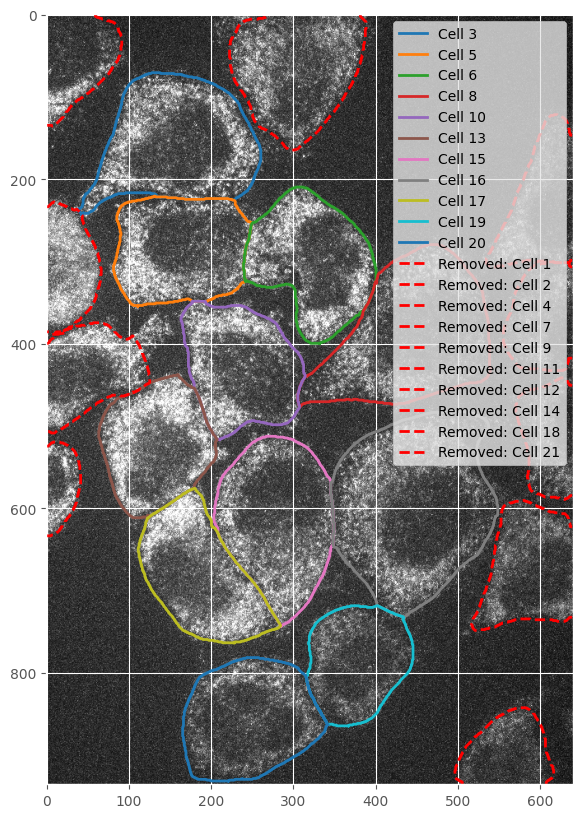

Chosen cell_label = 19 for further display steps.
No Foci in this cell


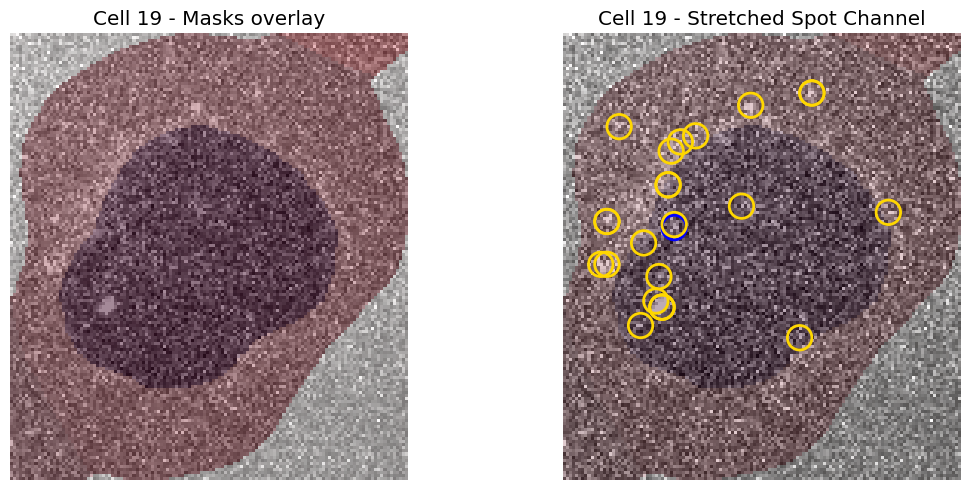

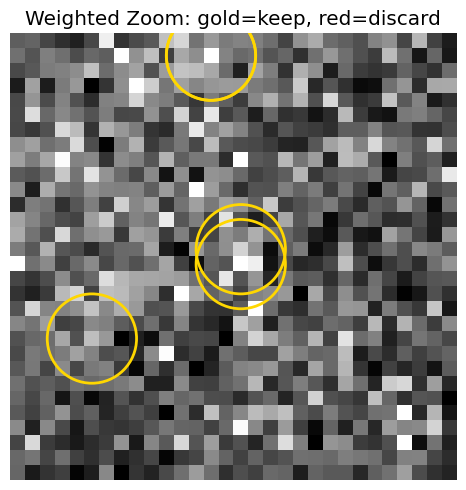

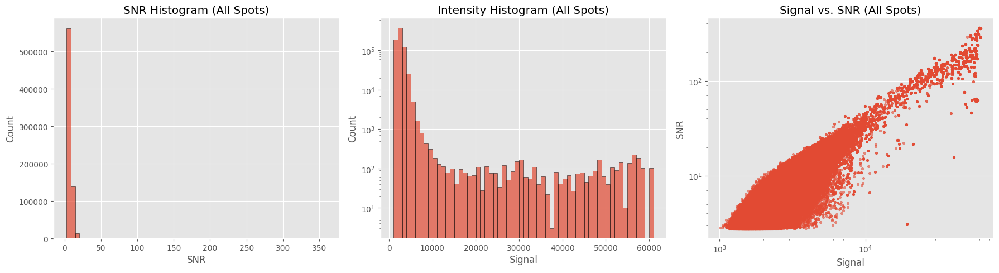

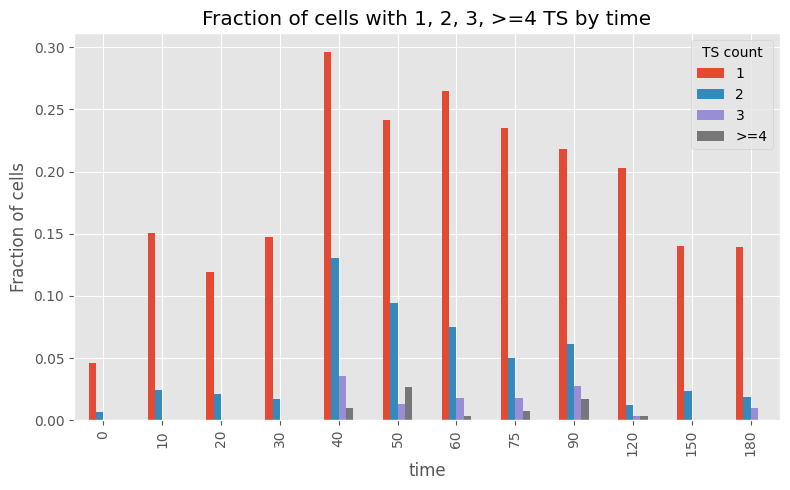

In [24]:
SD.display_gating_plus_display()

In [25]:
# Use measure_DUSP1 to create SSIT compatible dataframe
DUSP1_RepD = measure_DUSP1(SD.spots, SD.clusters, SD.cellprops)
am.close()

print(f'Total number of cells after filtering: {DUSP1_RepD.shape[0]}')
print(f"Total number of spots counted: {np.sum(DUSP1_RepD['num_spots'])}")

Total number of cells after filtering: 3647
Total number of spots counted: 721288


    DUSP1 100nM Dex 3hr Time-sweep Replica 2

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220421/DUSP1_100nM_Dex_R3_20220419_40min.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220421/DUSP1_100nM_Dex_R3_20220419_40min.h5 -> Analysis_DUSP1_E_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220425/DUSP1_100nM_Dex_R3_20220419_180min.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220425/DUSP1_100nM_Dex_R3_20220419_180min.h5 -> Analysis_DUSP1_E_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220421/DUSP1_100nM_Dex_R3_20220419_75min.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220421/DUSP1_100nM_Dex_R3_20220419_75min.h5 -> Analysis_DUSP1_E_NoThreshold_2025-02-21/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220420/DUSP1_100nM_Dex_R3_20220419_0min.h5
Reading DataFrame from: /Volumes/share/smFISH_im

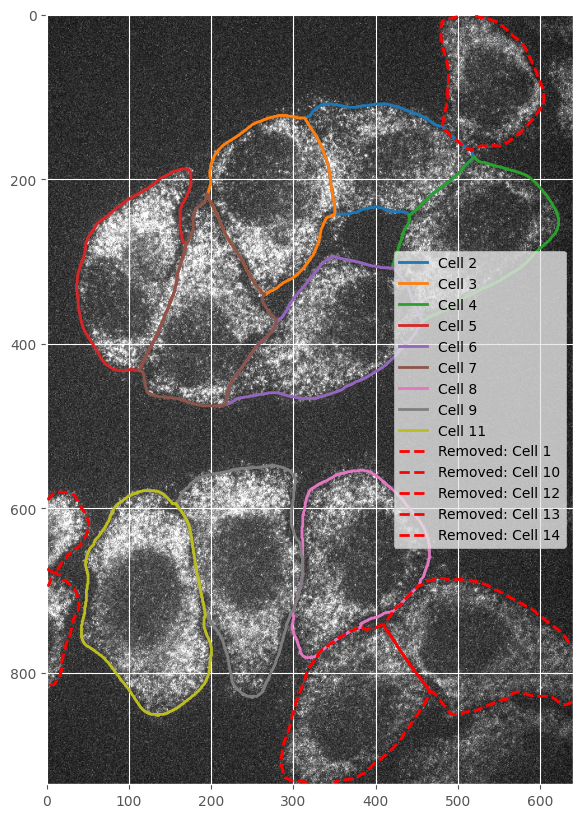

Chosen cell_label = 7 for further display steps.


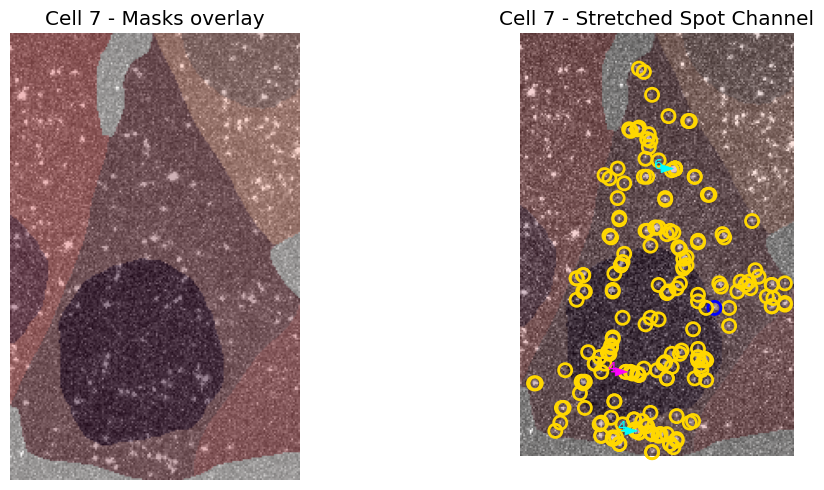

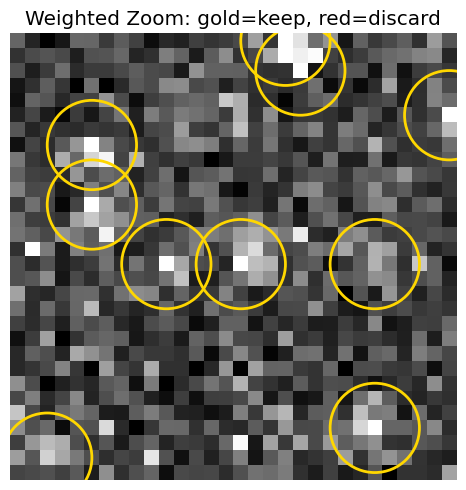

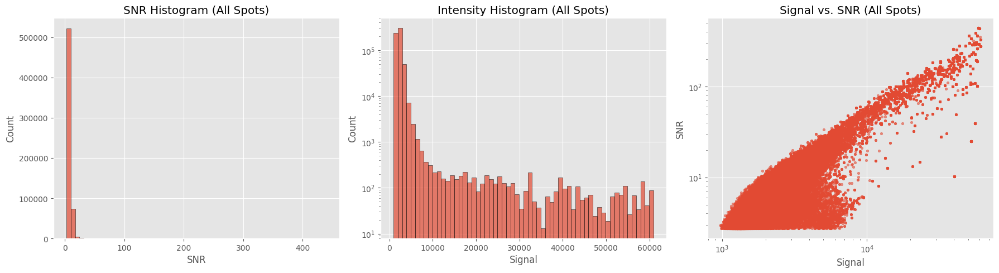

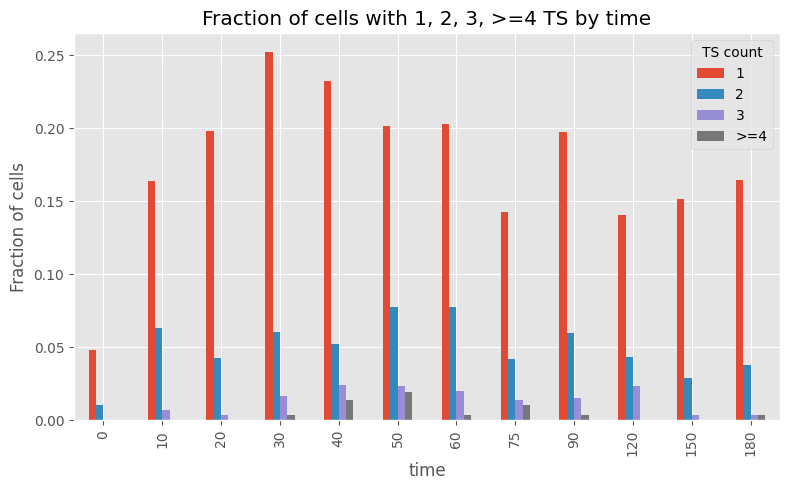

Total number of cells after filtering: 3454
Total number of spots counted: 606743


In [26]:
DUSP1_RepE = filter_DUSP1('DUSP1_E_NoThreshold')

    DUSP1 100nM Dex 3hr Time-sweep Replica 3

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220602/DUSP1_Dex_100nM_0min_NoSpin_052722.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220602/DUSP1_Dex_100nM_0min_NoSpin_052722.h5 -> Analysis_DUSP1_F_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220606/DUSP1_Dex_100nM_60min_NoSpin_052722.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220606/DUSP1_Dex_100nM_60min_NoSpin_052722.h5 -> Analysis_DUSP1_F_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220602/DUSP1_Dex_100nM_10min_NoSpin_052722.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220602/DUSP1_Dex_100nM_10min_NoSpin_052722.h5 -> Analysis_DUSP1_F_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220606/DUSP1_Dex_100nM_75min_NoSpin_052722.h5
Reading DataFrame from: /Volumes/shar

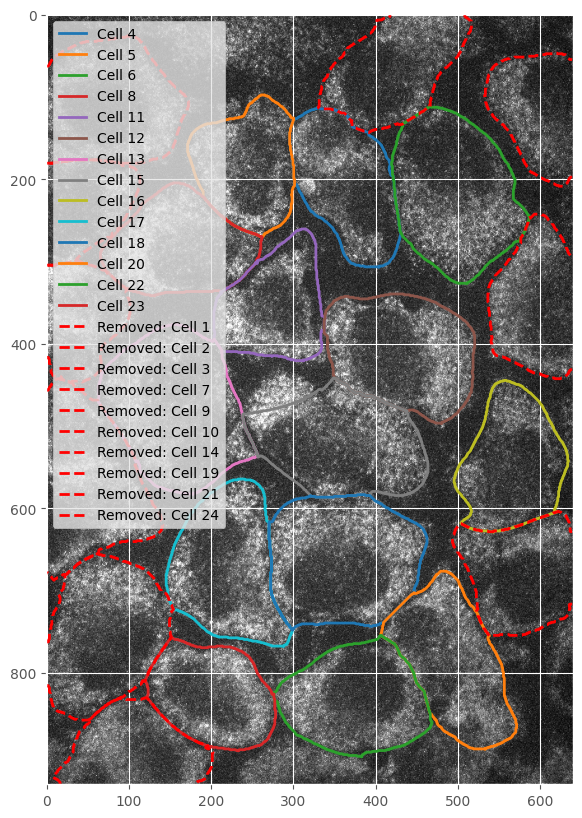

Chosen cell_label = 12 for further display steps.
No Foci in this cell


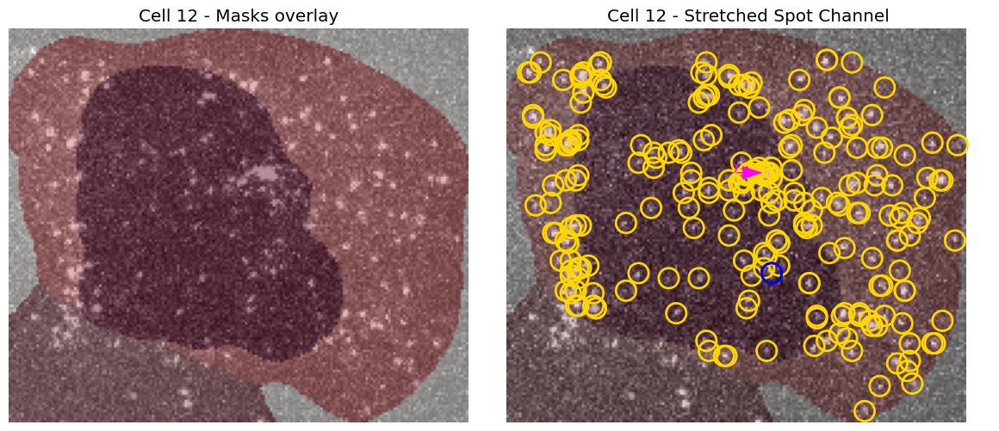

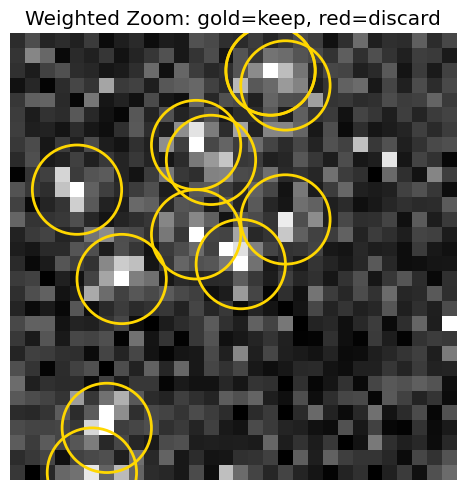

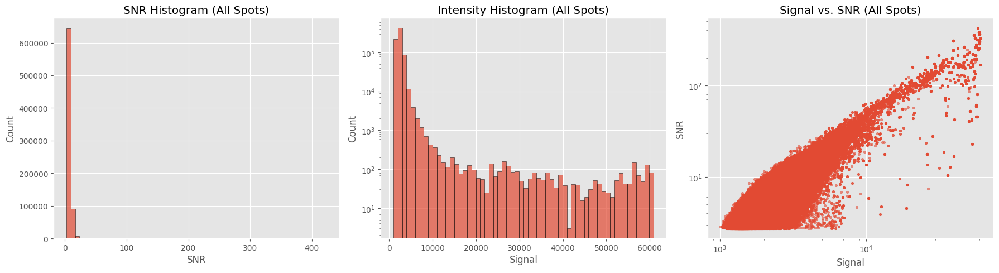

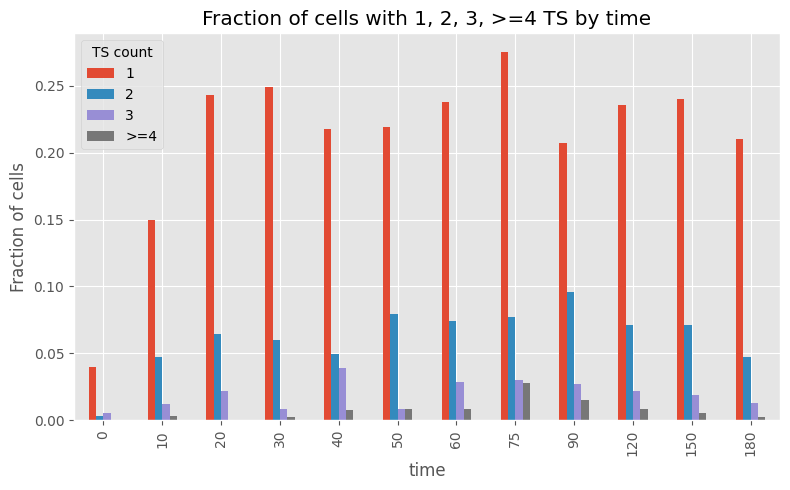

Total number of cells after filtering: 4290
Total number of spots counted: 749314


In [27]:
DUSP1_RepF = filter_DUSP1('DUSP1_F_NoThreshold')                        

    DUSP1 100nM Dex 3hr Time-sweep Replica 4 (partial)

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_150min_072022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_150min_072022.h5 -> Analysis_DUSP1_M_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_0min_072022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_0min_072022.h5 -> Analysis_DUSP1_M_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_180min_072022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_180min_072022.h5 -> Analysis_DUSP1_M_NoThreshold_2025-02-22/spotresults
Successfully loaded 3 DataFrames. Merging...
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220725/DUSP1_Dex_100nM_6hr_150min_072022.h5
Reading 

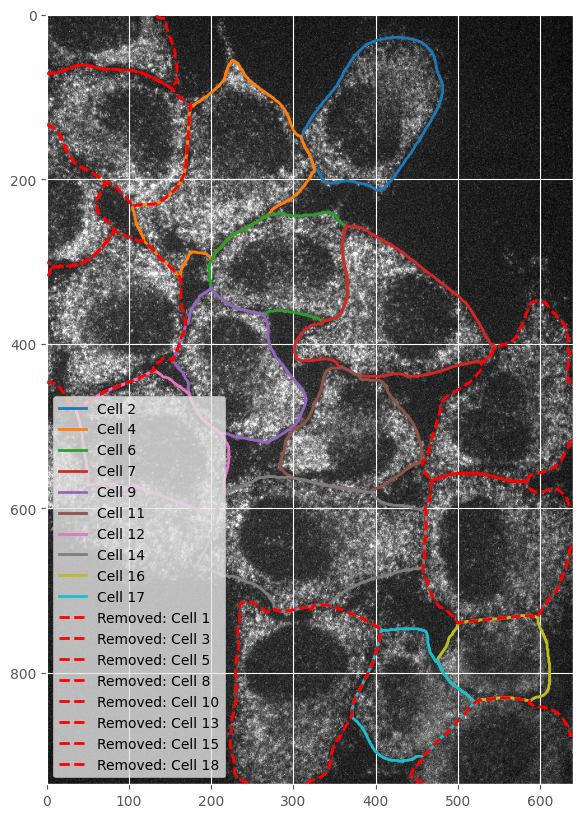

Chosen cell_label = 17 for further display steps.


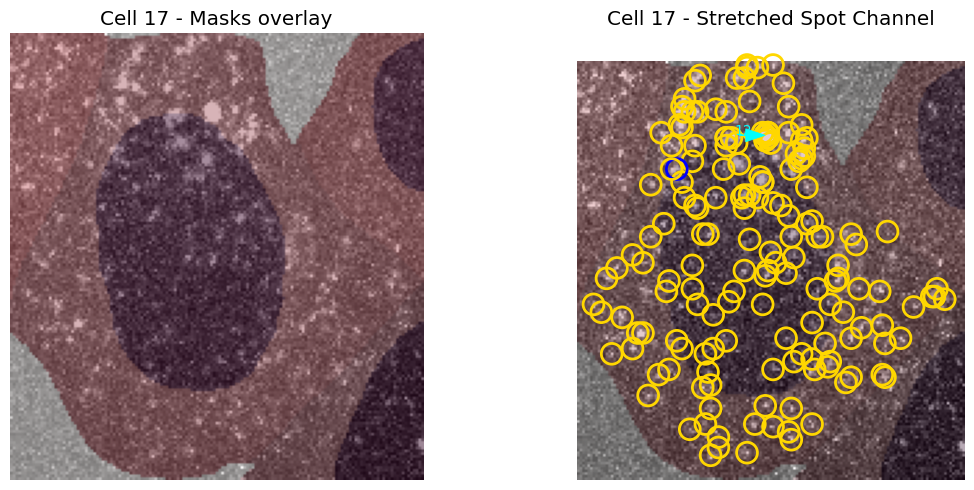

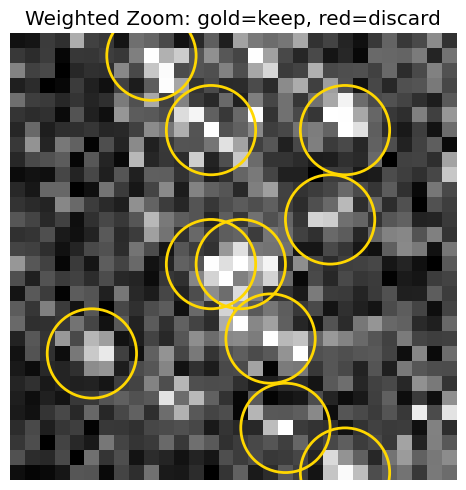

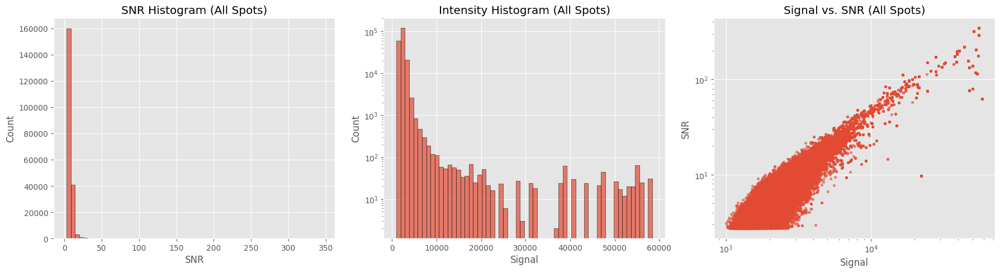

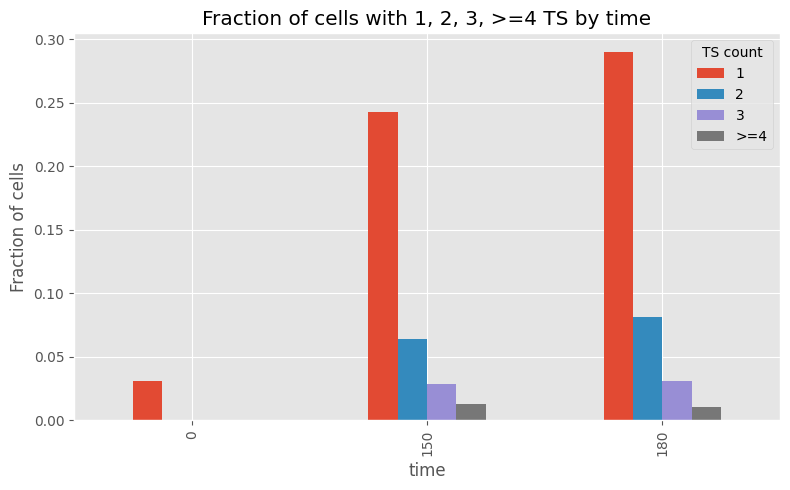

Total number of cells after filtering: 1170
Total number of spots counted: 206250


In [28]:
DUSP1_RepM = filter_DUSP1('DUSP1_M_NoThreshold')                        

    DUSP1 100nM Dex 3hr Time-sweep Replica 5 (partial)

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220927/DUSP1_100nM_Dex_60min_081822.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220927/DUSP1_100nM_Dex_60min_081822.h5 -> Analysis_DUSP1_N_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220929/DUSP1_100nM_Dex_180min_081822.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220929/DUSP1_100nM_Dex_180min_081822.h5 -> Analysis_DUSP1_N_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220927/DUSP1_100nM_Dex_30min_081822.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220927/DUSP1_100nM_Dex_30min_081822.h5 -> Analysis_DUSP1_N_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220928/DUSP1_100nM_Dex_150min_081822.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220928/

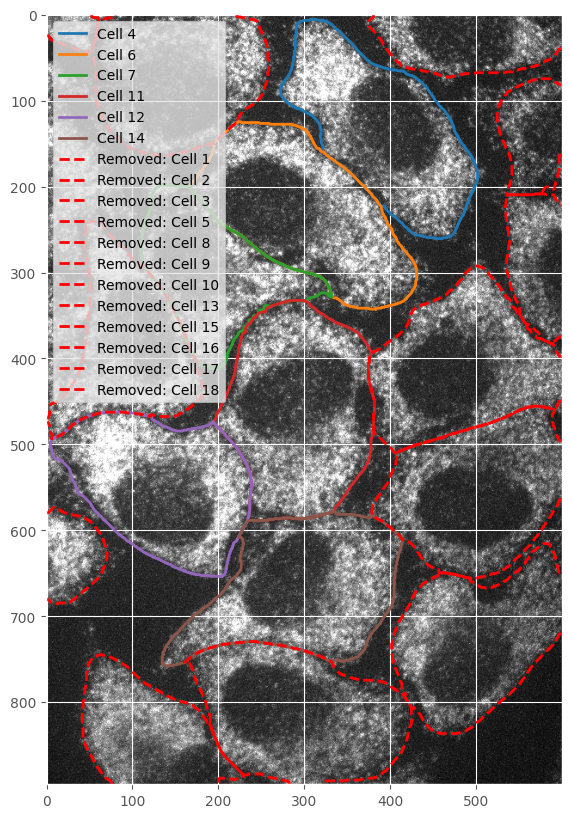

Chosen cell_label = 11 for further display steps.
No Foci in this cell


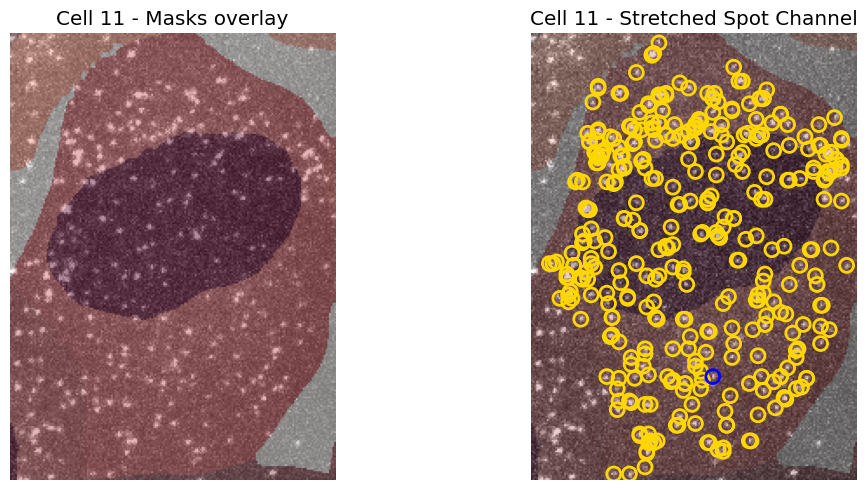

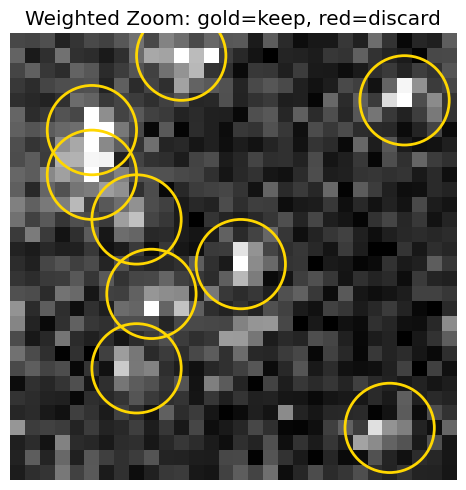

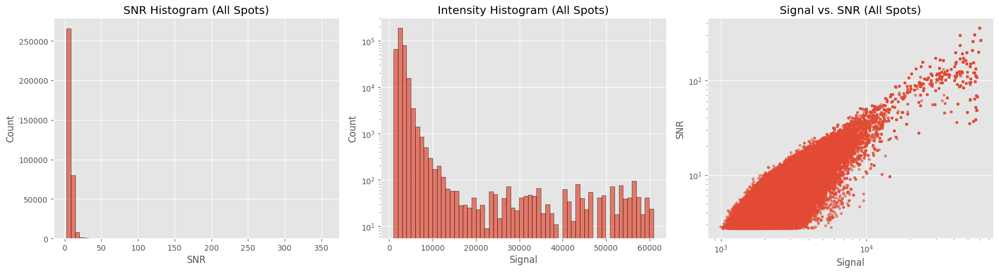

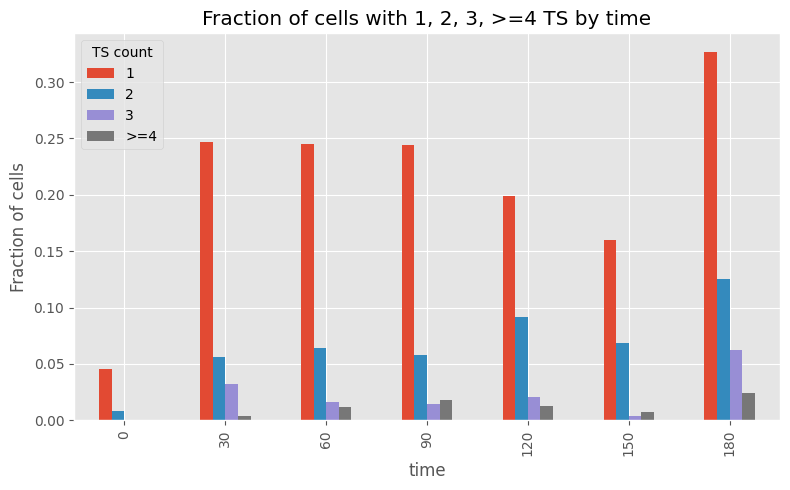

Total number of cells after filtering: 1732
Total number of spots counted: 358283


In [29]:
DUSP1_RepN = filter_DUSP1('DUSP1_N_NoThreshold')

    DUSP1 75min Concentration-sweep Replica 1

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220707/DUSP1_conc_sweep_100pM_75min_060322.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220707/DUSP1_conc_sweep_100pM_75min_060322.h5 -> Analysis_DUSP1_G_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220628/DUSP1_conc_sweep_0min_060322.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220628/DUSP1_conc_sweep_0min_060322.h5 -> Analysis_DUSP1_G_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220705/DUSP1_conc_sweep_10nM_75min_060322.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220705/DUSP1_conc_sweep_10nM_75min_060322.h5 -> Analysis_DUSP1_G_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220707/DUSP1_conc_sweep_1pM_75min_060322.h5
Reading DataFrame from: /Volumes/share/smFISH_images/

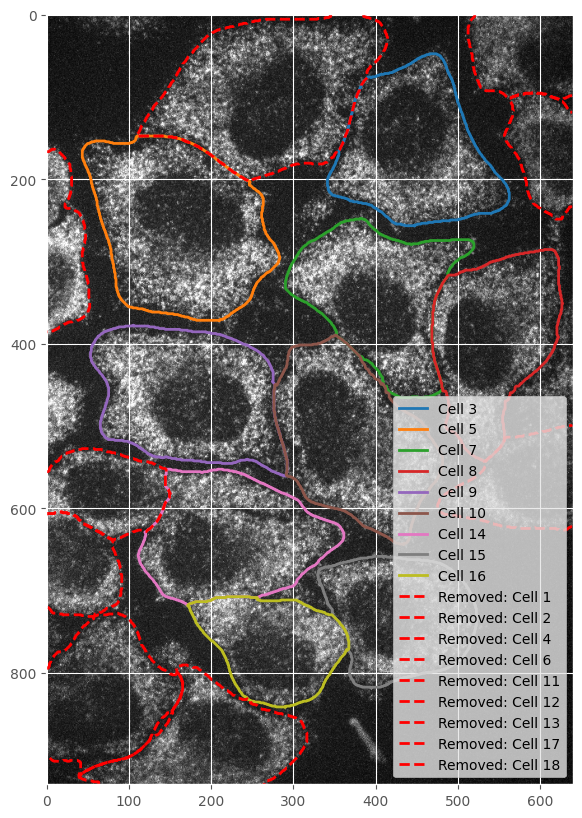

Chosen cell_label = 3 for further display steps.


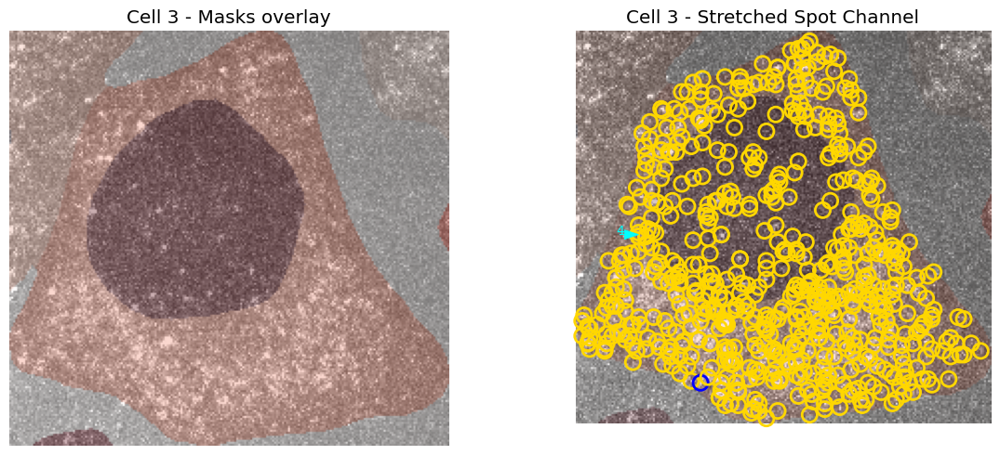

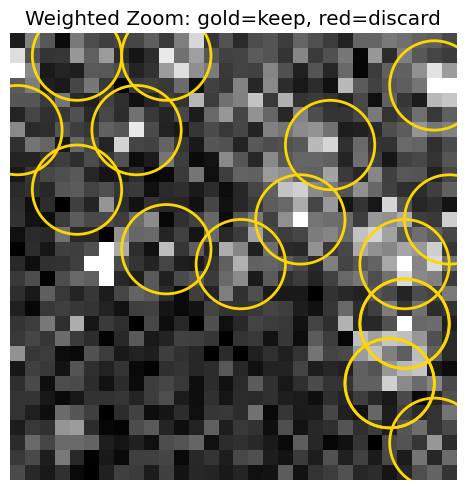

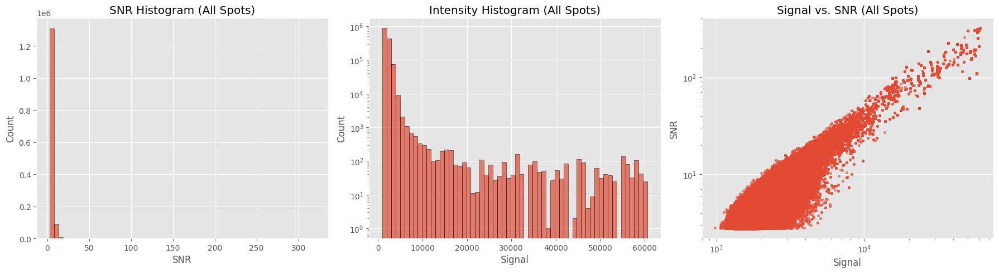

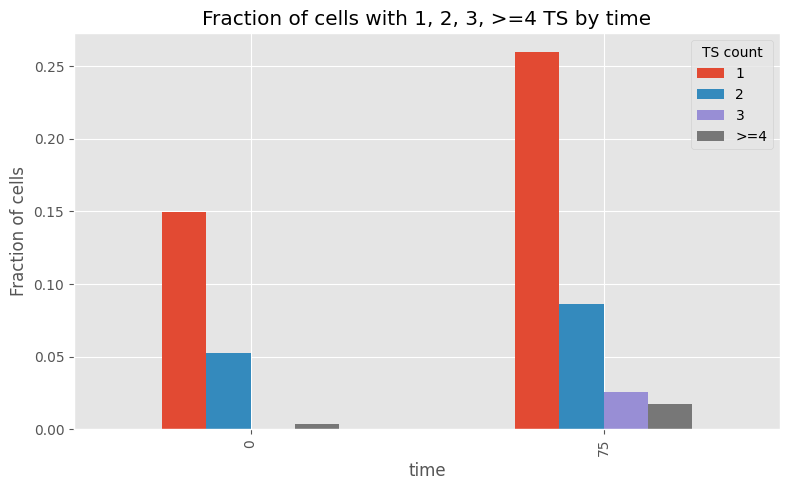

Total number of cells after filtering: 2632
Total number of spots counted: 1412695


In [30]:
DUSP1_RepG = filter_DUSP1('DUSP1_G_NoThreshold')                        

    DUSP1 75min Concentration-sweep Replica 2

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220721/DUSP1_conc_sweep_R2_10pM_75min_071422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220721/DUSP1_conc_sweep_R2_10pM_75min_071422.h5 -> Analysis_DUSP1_H_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220718/DUSP1_conc_sweep_R2_0min_071422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220718/DUSP1_conc_sweep_R2_0min_071422.h5 -> Analysis_DUSP1_H_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220721/DUSP1_conc_sweep_R2_100pM_75min_071422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20220721/DUSP1_conc_sweep_R2_100pM_75min_071422.h5 -> Analysis_DUSP1_H_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20220721/DUSP1_conc_sweep_R2_1pM_75min_071422.h5
Reading DataFrame from: /Volumes

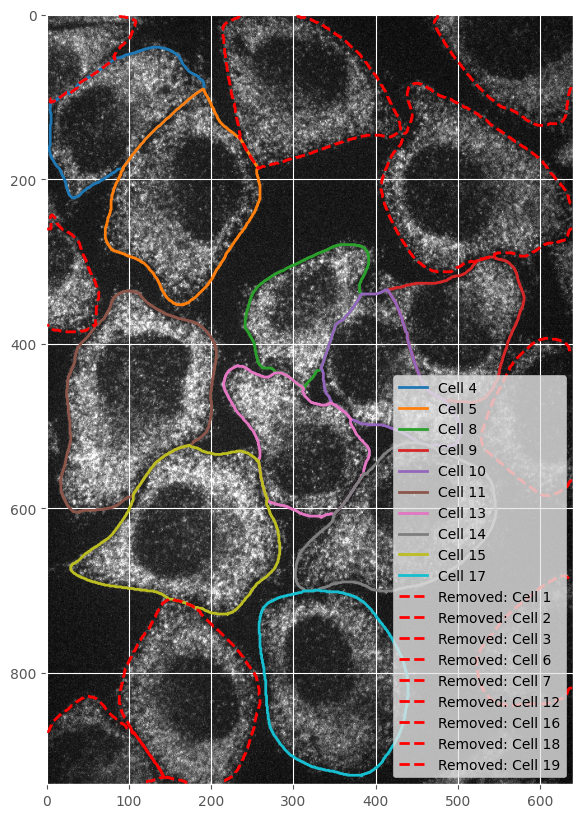

Chosen cell_label = 5 for further display steps.
No Foci in this cell


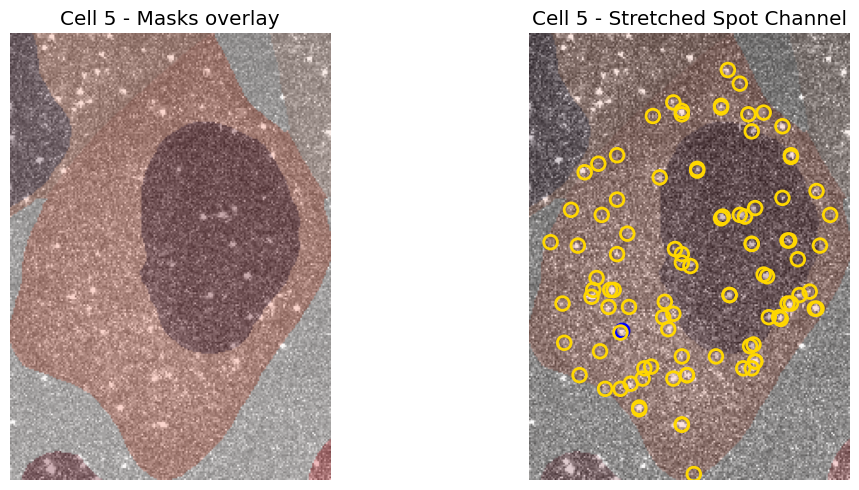

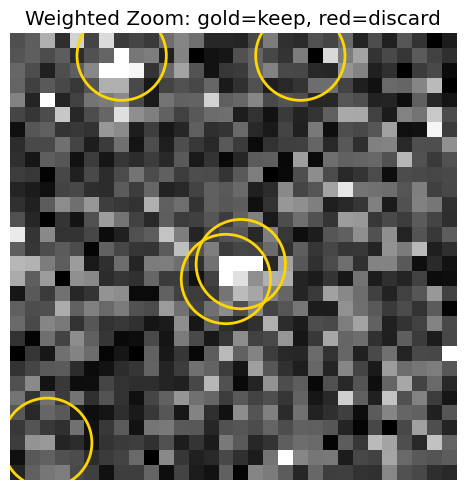

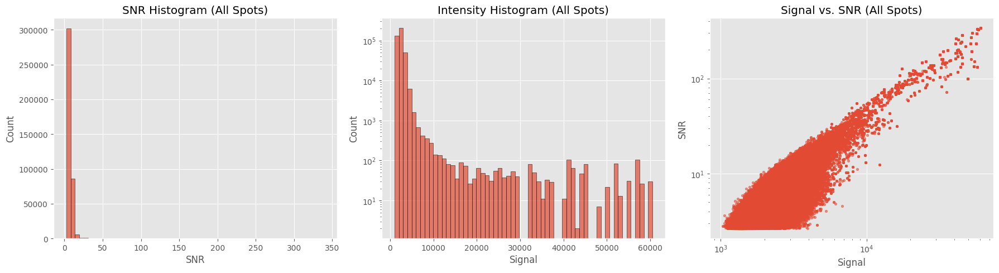

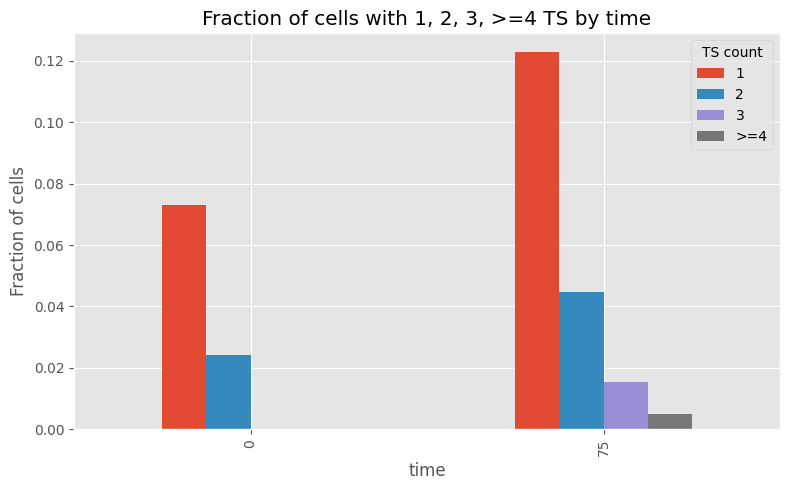

Total number of cells after filtering: 2283
Total number of spots counted: 398493


In [31]:
DUSP1_RepH = filter_DUSP1('DUSP1_H_NoThreshold')                         

    DUSP1 75min Concentration-sweep Replica 3

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221011/DUSP1_Dex_Sweep_1uM_75min_092022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221011/DUSP1_Dex_Sweep_1uM_75min_092022.h5 -> Analysis_DUSP1_I_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221003/DUSP1_Dex_Sweep_10pM_75min_092022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221003/DUSP1_Dex_Sweep_10pM_75min_092022.h5 -> Analysis_DUSP1_I_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221006/DUSP1_Dex_Sweep_1nM_75min_092022.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221006/DUSP1_Dex_Sweep_1nM_75min_092022.h5 -> Analysis_DUSP1_I_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221006/DUSP1_Dex_Sweep_100nM_75min_092022.h5
Reading DataFrame from: /Volumes/share/smFISH_images

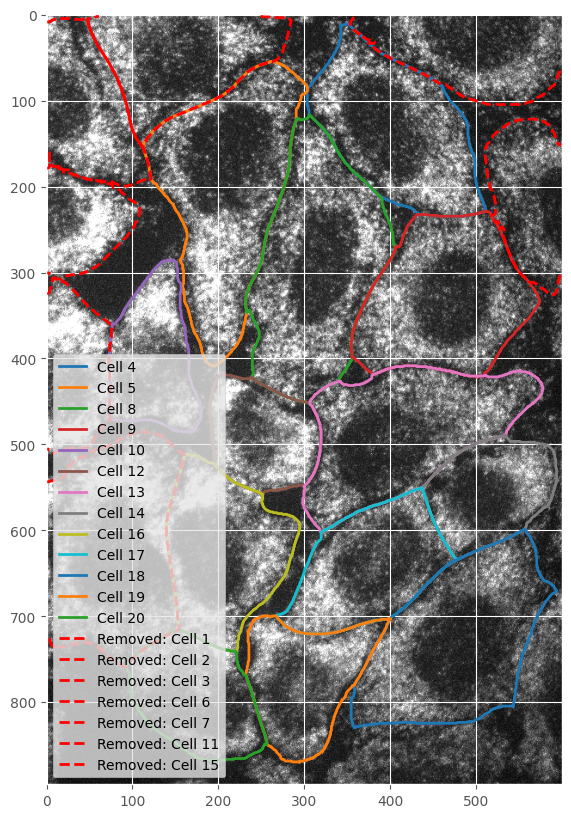

Chosen cell_label = 19 for further display steps.
No Foci in this cell


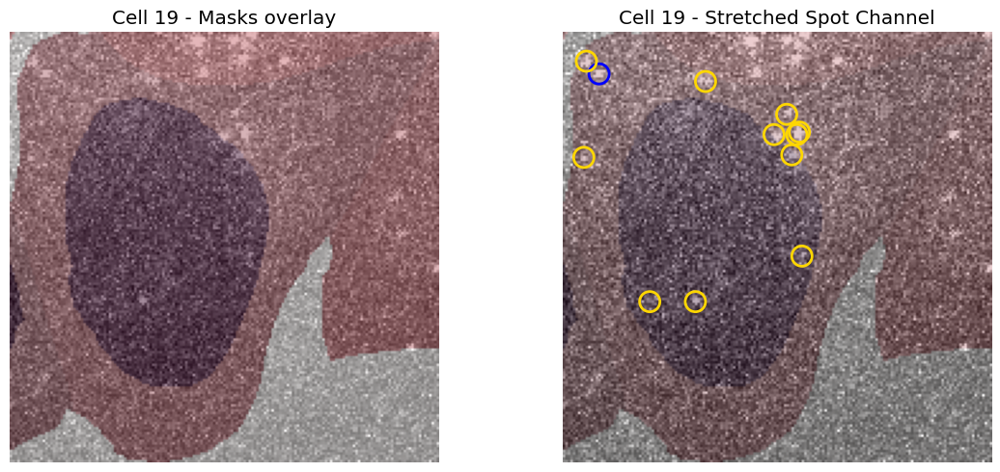

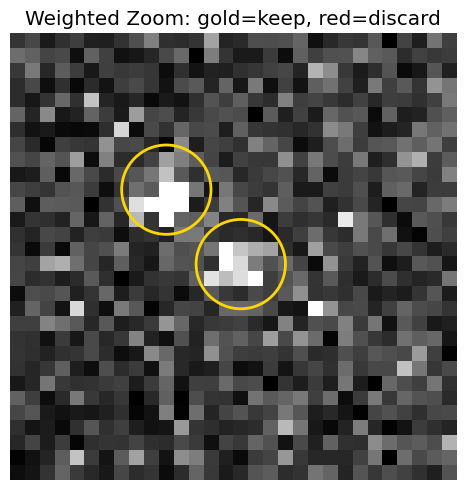

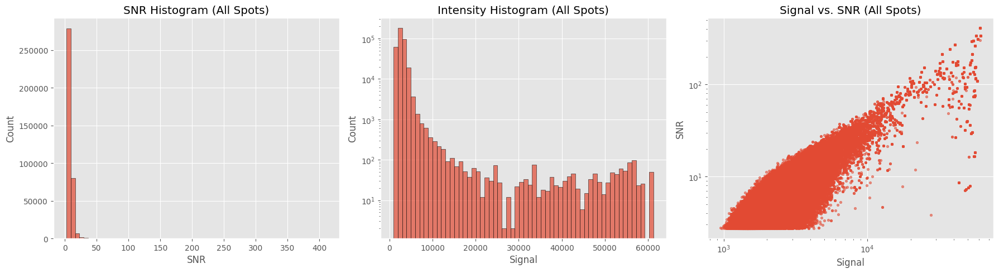

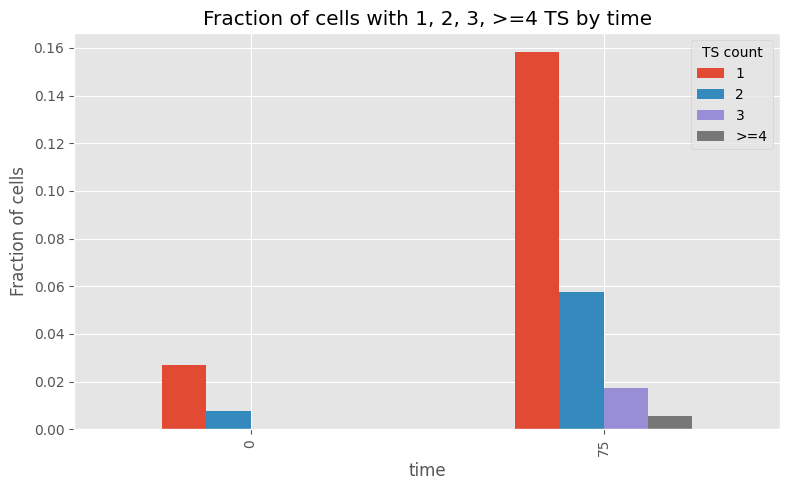

Total number of cells after filtering: 2309
Total number of spots counted: 369659


In [32]:
DUSP1_RepI = filter_DUSP1('DUSP1_I_NoThreshold')

    DUSP1 0.3, 1, 10nM Dex 3hr Time-sweep Replica 1

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230316/DUSP1_10nM_Dex_50min_012623.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230316/DUSP1_10nM_Dex_50min_012623.h5 -> Analysis_DUSP1_J_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230306/DUSP1_300pM_Dex_50min_012623.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230306/DUSP1_300pM_Dex_50min_012623.h5 -> Analysis_DUSP1_J_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230309/DUSP1_300pM_Dex_180min_012623.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230309/DUSP1_300pM_Dex_180min_012623.h5 -> Analysis_DUSP1_J_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230316/DUSP1_1nM_Dex_180min_012623.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230316/DUSP

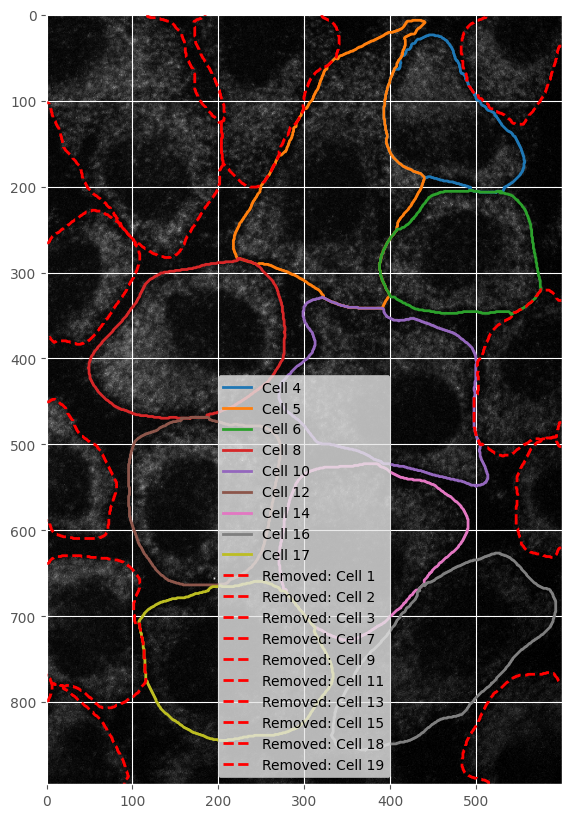

Chosen cell_label = 6 for further display steps.
No Foci in this cell


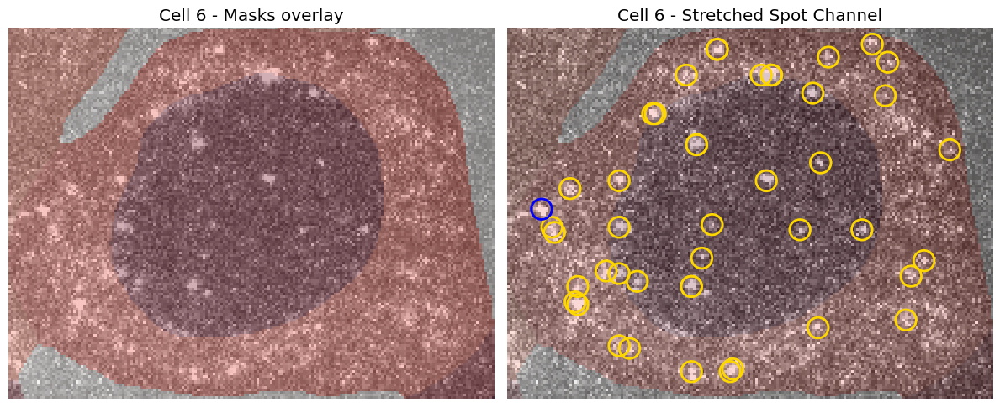

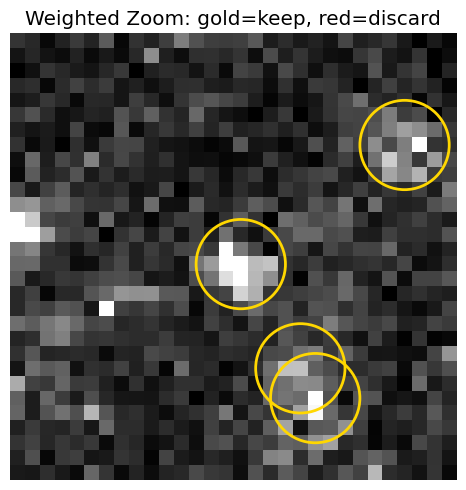

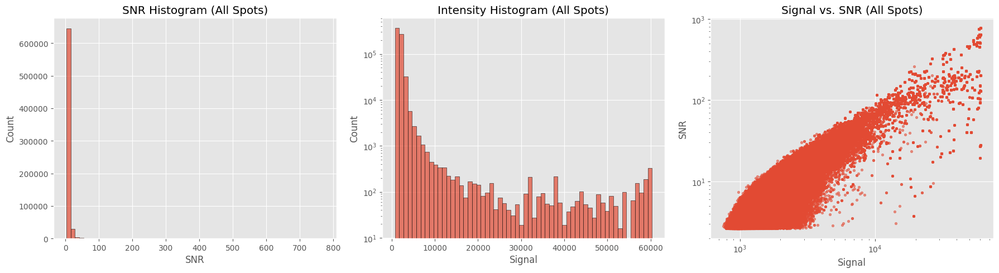

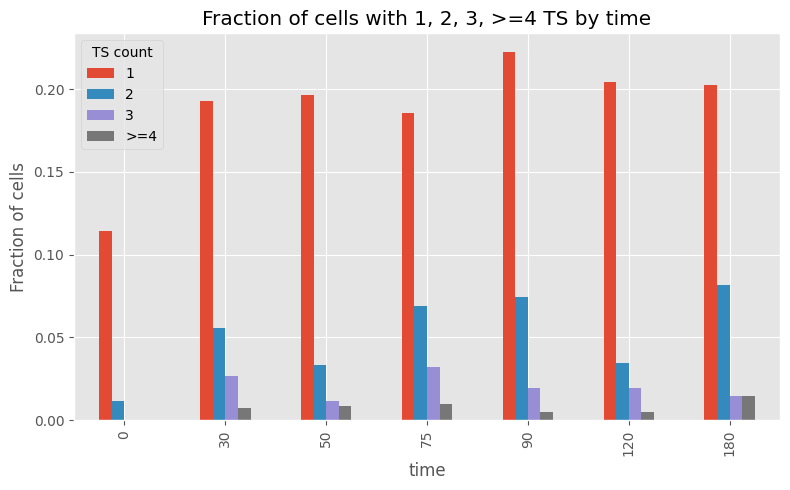

Total number of cells after filtering: 5135
Total number of spots counted: 684644


In [33]:
DUSP1_RepJ = filter_DUSP1('DUSP1_J_NoThreshold')


    DUSP1 0.3, 1, 10nM Dex 3hr Time-sweep Replica 2

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230424/DUSP1_DexTimeConcSweep_1nM_30min_041223.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230424/DUSP1_DexTimeConcSweep_1nM_30min_041223.h5 -> Analysis_DUSP1_K_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230424/DUSP1_DexTimeConcSweep_300pM_120min_041223.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230424/DUSP1_DexTimeConcSweep_300pM_120min_041223.h5 -> Analysis_DUSP1_K_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230413/DUSP1_DexTimeConcSweep_300pM_30min_041223.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230413/DUSP1_DexTimeConcSweep_300pM_30min_041223.h5 -> Analysis_DUSP1_K_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230427/DUSP1_DexTimeConcSweep_10nM_30min_041223

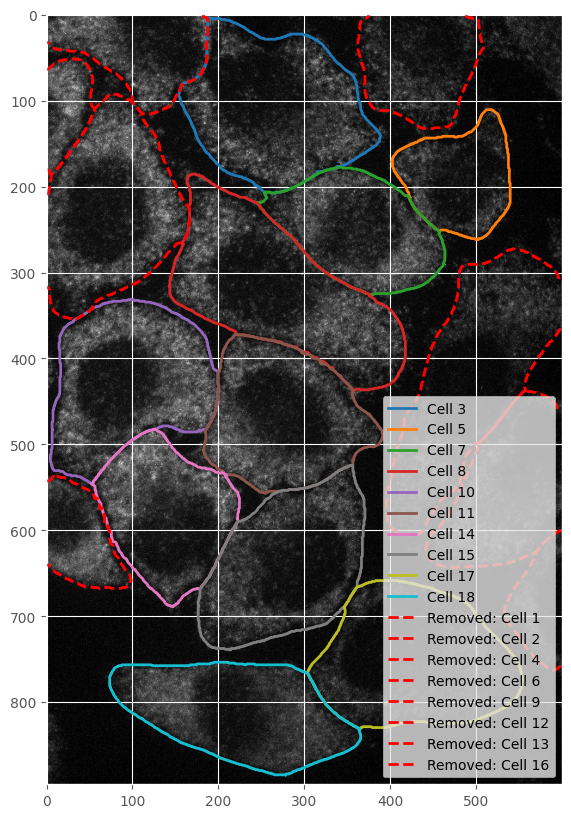

Chosen cell_label = 18 for further display steps.
No Foci in this cell


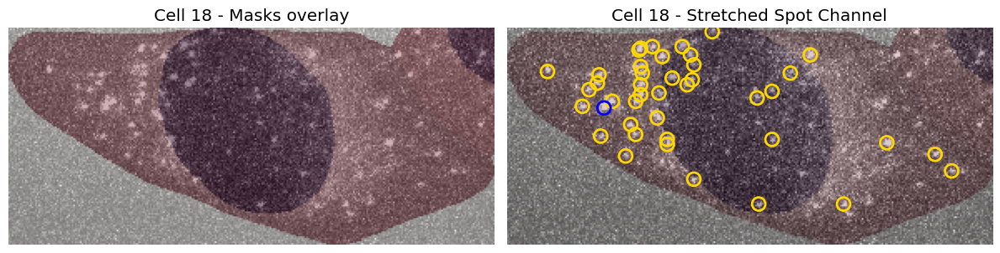

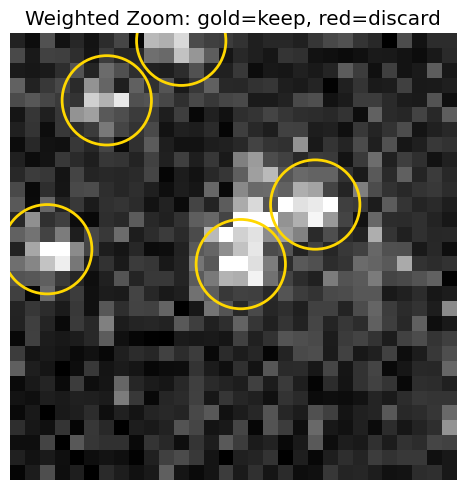

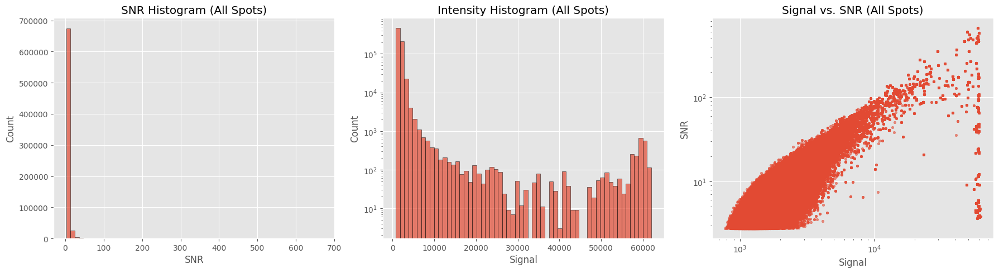

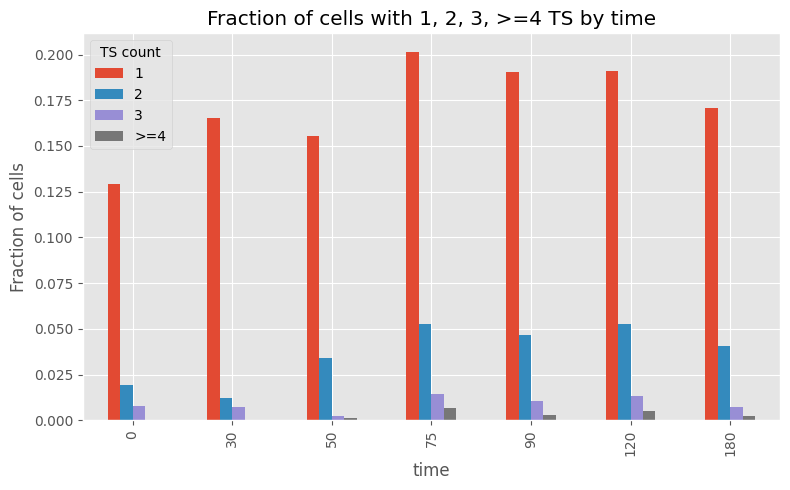

Total number of cells after filtering: 5176
Total number of spots counted: 709548


In [34]:
DUSP1_RepK = filter_DUSP1('DUSP1_K_NoThreshold')

    DUSP1 0.3, 1, 10nM Dex 3hr Time-sweep Replica 3

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230530/DUSP1_Dex_time_conc_sweep_0min_050223_R3.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230530/DUSP1_Dex_time_conc_sweep_0min_050223_R3.h5 -> Analysis_DUSP1_L_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230614/DUSP1_Dex_10nM_30min_050223_R3_redo.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230614/DUSP1_Dex_10nM_30min_050223_R3_redo.h5 -> Analysis_DUSP1_L_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230608/DUSP1_Dex_10nM_120min_050223_R3.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20230608/DUSP1_Dex_10nM_120min_050223_R3.h5 -> Analysis_DUSP1_L_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20230605/DUSP1_Dex_300pM_90min_050223_R3.h5
Reading DataFrame from: /Volumes/shar

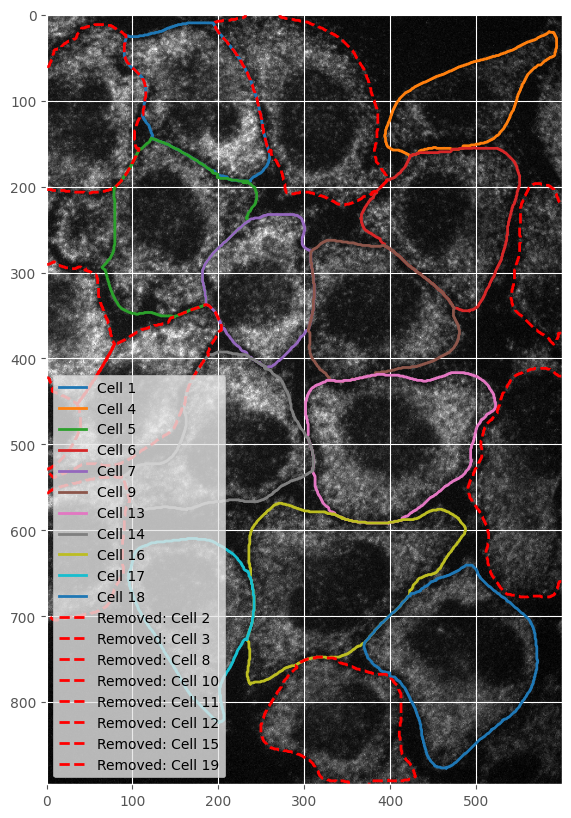

Chosen cell_label = 4 for further display steps.
No Foci in this cell


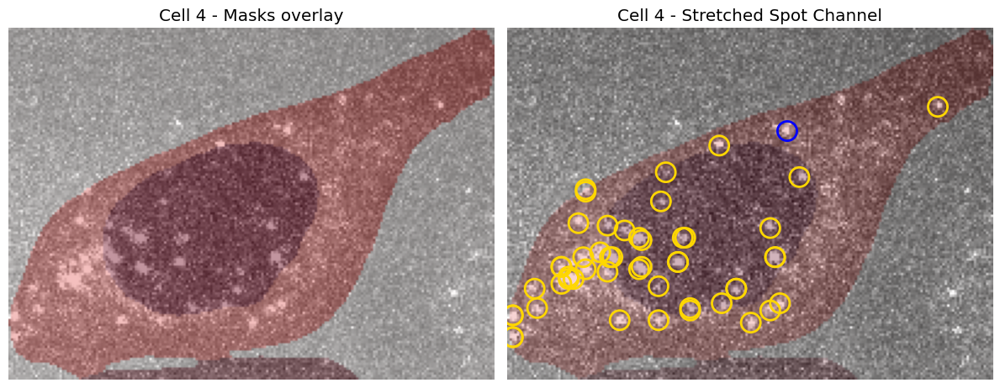

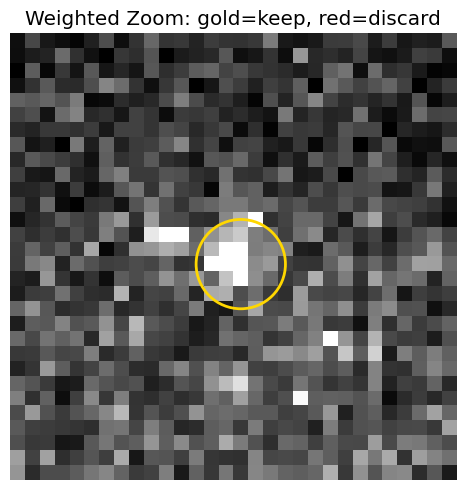

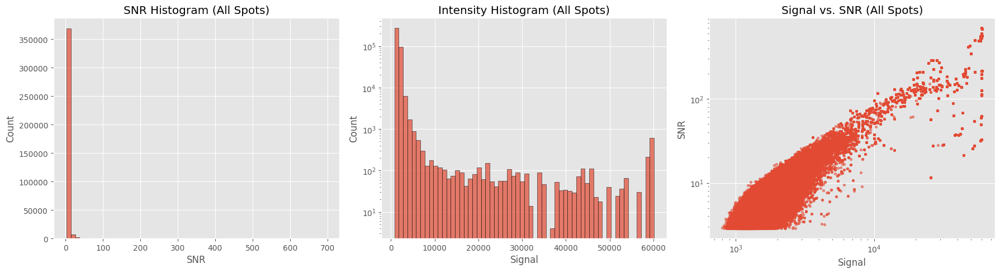

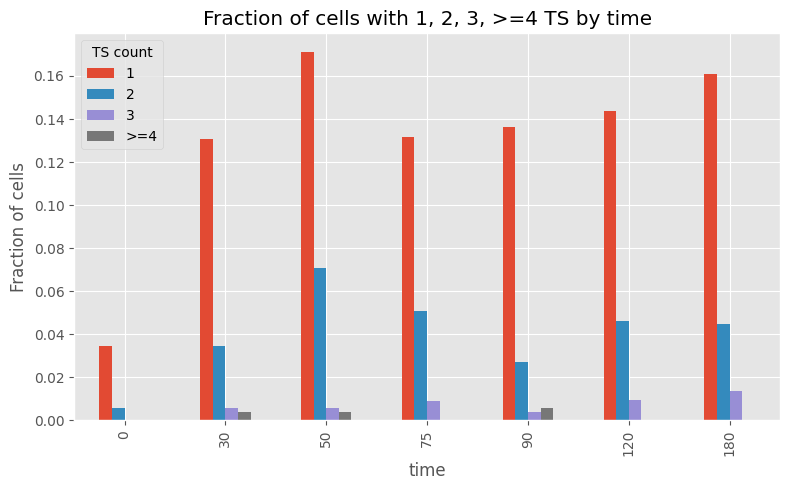

Total number of cells after filtering: 3095
Total number of spots counted: 381019


In [35]:
DUSP1_RepL = filter_DUSP1('DUSP1_L_NoThreshold')

    DUSP1 100nM Dex & 5µM TPL Time-sweep Replica 1

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_30min_101422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_30min_101422.h5 -> Analysis_DUSP1_O_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_60min_101422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_60min_101422.h5 -> Analysis_DUSP1_O_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_10min_101422.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex100nM_75min_TPL5uM_10min_101422.h5 -> Analysis_DUSP1_O_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221019/DUSP1_Dex_TPL_3hr_0min_Control_101422.h5
Rea

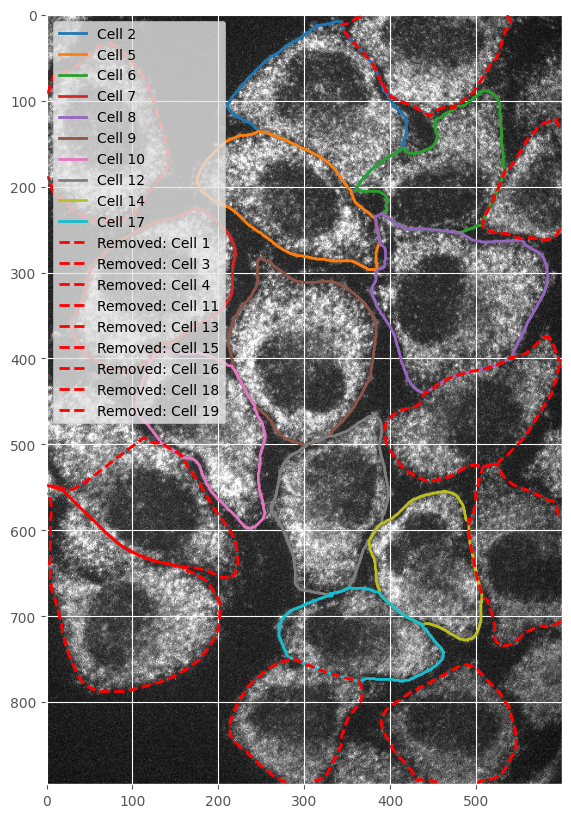

Chosen cell_label = 14 for further display steps.
No Foci in this cell


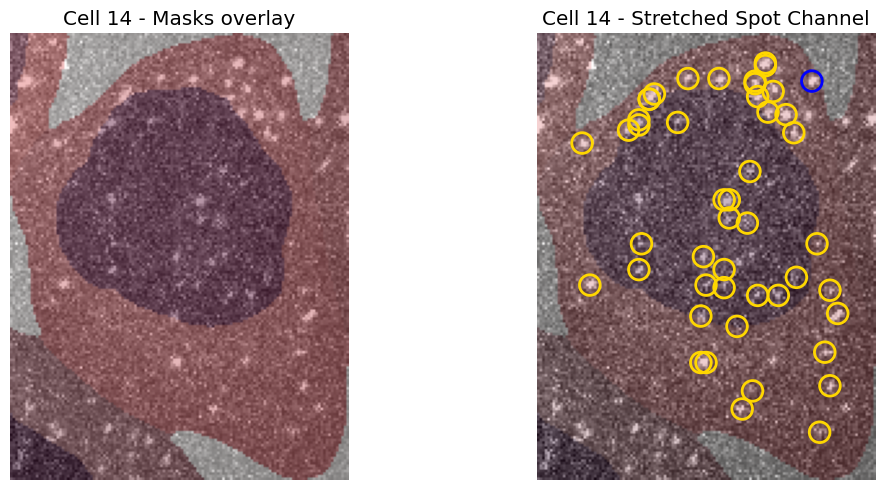

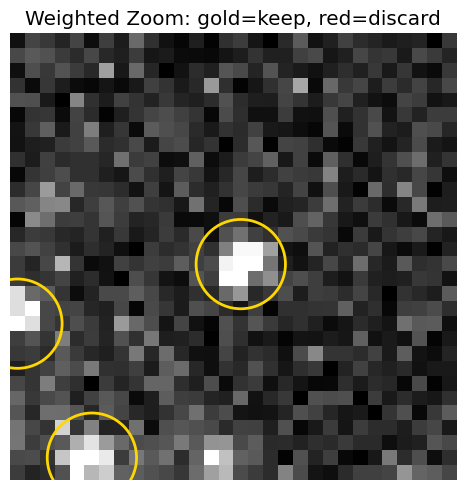

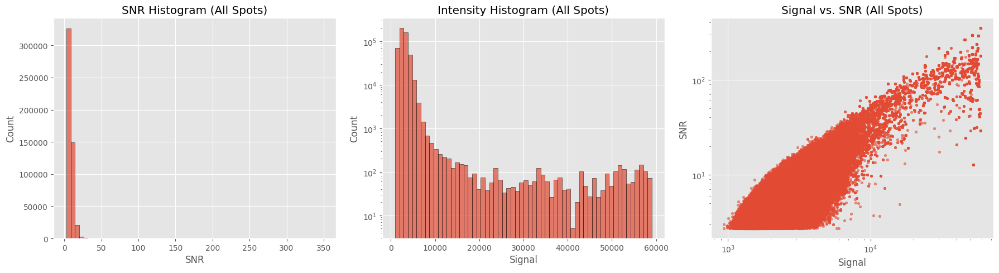

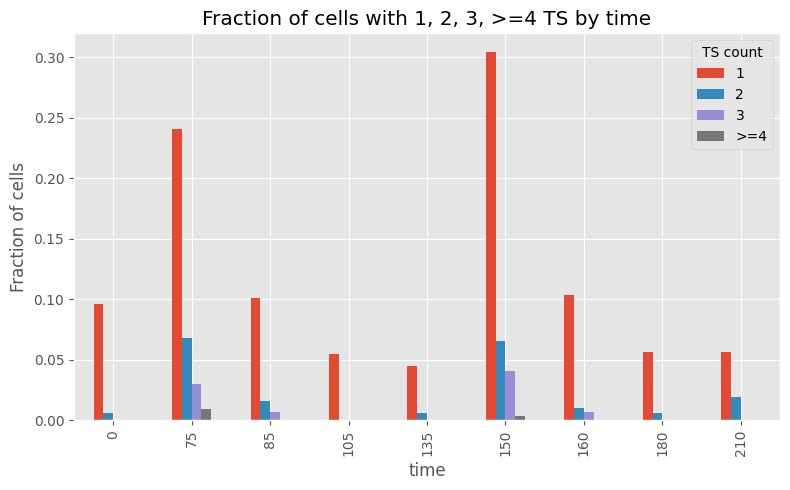

Total number of cells after filtering: 2806
Total number of spots counted: 505212


In [36]:
DUSP1_RepO_TPL = filter_DUSP1('DUSP1_O_NoThreshold', True)

    DUSP1 100nM Dex & 5µM TPL Time-sweep Replica 2

Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221103/DUSP1_Dex_0min_TPL_30min_110222.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221103/DUSP1_Dex_0min_TPL_30min_110222.h5 -> Analysis_DUSP1_P_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221107/DUSP1_Dex_20min_TPL_30min_110222.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221107/DUSP1_Dex_20min_TPL_30min_110222.h5 -> Analysis_DUSP1_P_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221103/DUSP1_Dex_0min_TPL_0min_110222.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFISH_images/20221103/DUSP1_Dex_0min_TPL_0min_110222.h5 -> Analysis_DUSP1_P_NoThreshold_2025-02-22/spotresults
Opening file: /Volumes/share/smFISH_images/Eric_smFISH_images/20221103/DUSP1_Dex_0min_TPL_60min_110222.h5
Reading DataFrame from: /Volumes/share/smFISH_images/Eric_smFIS

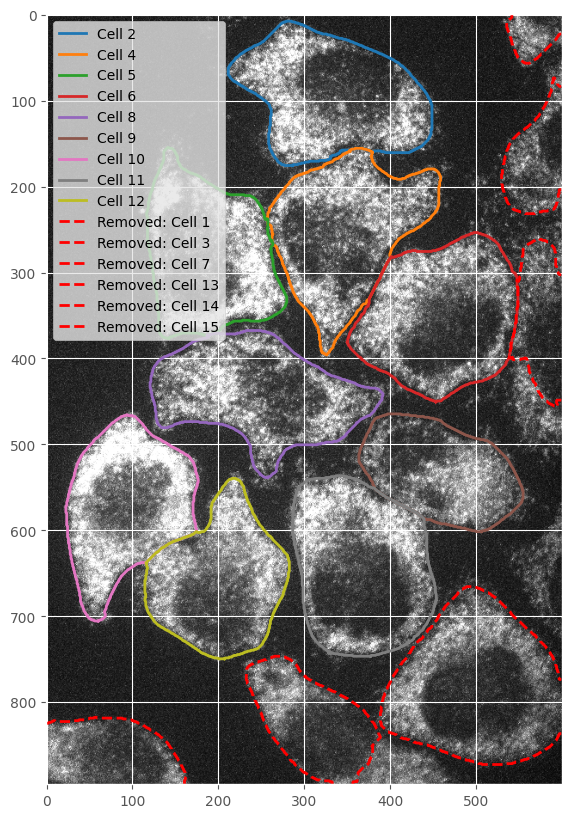

Chosen cell_label = 4 for further display steps.
No Foci in this cell


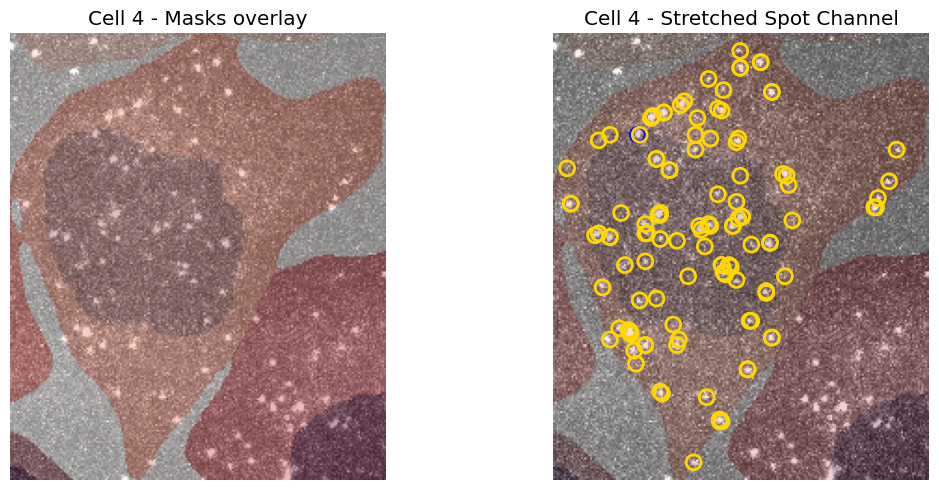

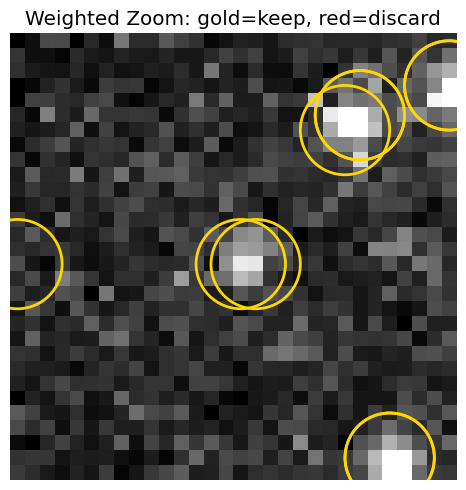

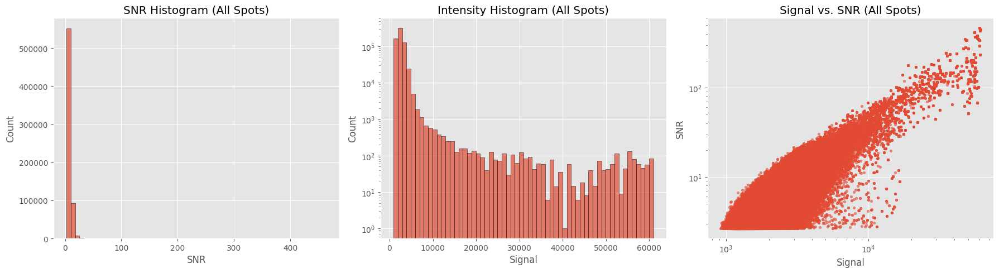

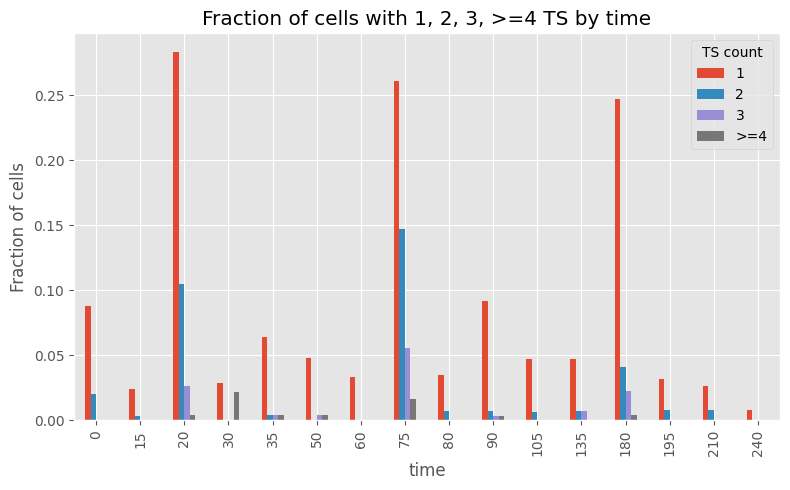

Total number of cells after filtering: 4404
Total number of spots counted: 658095


In [37]:
DUSP1_RepP_TPL = filter_DUSP1('DUSP1_P_NoThreshold', True)

In [38]:
# label Dex-only frames as TPL = False
for df in [DUSP1_RepD, DUSP1_RepE, DUSP1_RepF, DUSP1_RepM, DUSP1_RepN,
           DUSP1_RepG, DUSP1_RepH, DUSP1_RepI, DUSP1_RepJ, DUSP1_RepK, DUSP1_RepL]:
    df['is_TPL'] = False

# Label TPL frames as TPL = True
for df in [DUSP1_RepO_TPL, DUSP1_RepP_TPL]:
    df['is_TPL'] = True

# 1) Concatenate Dex-only DUSP1 data
DUSP1_ALL = pd.concat(
    [DUSP1_RepD, DUSP1_RepE, DUSP1_RepF, DUSP1_RepM, DUSP1_RepN,
     DUSP1_RepG, DUSP1_RepH, DUSP1_RepI, DUSP1_RepJ, DUSP1_RepK, DUSP1_RepL],
    ignore_index=True
)
DUSP1_ALL['unique_cell_id'] = np.arange(len(DUSP1_ALL))

# 2) Concatenate TPL data
DUSP1_TPL = pd.concat(
    [DUSP1_RepO_TPL, DUSP1_RepP_TPL],
    ignore_index=True
)
DUSP1_TPL['unique_cell_id'] = np.arange(len(DUSP1_TPL))

# 3) Create a combined DataFrame (Dex + TPL), preserving the is_TPL flag
DUSP1_Dex_TPL_ALL = pd.concat([DUSP1_ALL, DUSP1_TPL], 
                           ignore_index=True, 
                           sort=False)
# Assign a new unique_cell_id across the combined data
DUSP1_Dex_TPL_ALL['unique_cell_id'] = np.arange(len(DUSP1_Dex_TPL_ALL))

In [39]:
from datetime import datetime

# SAVE THE PRE-GATED DATAFRAMES
# ============================
current_date = datetime.now().strftime("%b%d%y")

# (Optional) save each DataFrame to disk
DUSP1_ALL.to_csv(f'DUSP1_ALL_{current_date}_NoThreshold.csv', index=False)
DUSP1_TPL.to_csv(f'DUSP1_TPL_{current_date}_NoThreshold.csv', index=False)
DUSP1_Dex_TPL_ALL.to_csv(f'DUSP1_Dex_TPL_ALL_{current_date}_NoThreshold.csv', index=False)

## GR_ALL & DUSP1_All final dataframe preperation for SSIT

1) Fit a Polynomial (2nd-degree) using (nuc_area_px, cyto_area_px) from DUSP1_ALL.

2) Estimate Cytoplasm Area in GR_ALL:
3) Creates `CalcCytoArea` by evaluating the fitted polynomial at each row’s `nuc_area`.

4) Gate both data sets on the 25%–75% range of nuclear area.

5) Compute “Normalized” GR (`normGRnuc`, `normGRcyt`) in GR_ALL:
- Scales nuclear/cyt intensities (5%→95% range) into integer bins [0,30].

6) Plot Histograms for the normalized nuclear/cyt GR (using custom colors).

7) Save the updated, gated data sets to CSV.

In [40]:
# 1) READ INPUT DATA
# =========================
# DUSP1_ALL from above or load from disk:
if f'DUSP1_ALL_{current_date}_NoThreshold' in locals():
    df_dusp = DUSP1_ALL
else:
    df_dusp = pd.read_csv('DUSP1_ALL.csv')

# GR_ALL from above or load from disk:
if 'GR_ALL' in locals():
    df_gr = GR_ALL
else:
    df_gr = pd.read_csv('GR_ALL_pregate.csv')


# 2) FIT POLYNOMIAL TO (NUC, CYTO) FROM DUSP1_ALL
# =========================
# We'll use only the rows that have valid nuc_area_px and cyto_area_px.
num_cells = df_dusp.shape[0]
df_dusp_nonmissing = df_dusp.dropna(subset=['nuc_area_px', 'cyto_area_px']).copy()
print(f'Cells removed because of NaN areas in DUSP1: {df_dusp_nonmissing.shape[0] - num_cells}')


# 4) GATE DUSP1 DATAFRAME ON [25%, 75%] NUCLEAR AREA
# =========================
# We'll define a helper function for gating.
num_cells = df_dusp.shape[0]
def gate_on_nuc_area(df, nuc_col):
    """Return a copy of df gated to [25th, 75th percentile] of nuc_col."""
    lower = df[nuc_col].quantile(0.25)
    upper = df[nuc_col].quantile(0.75)
    return df[(df[nuc_col] >= lower) & (df[nuc_col] <= upper)].copy()

# Gate DUSP1_ALL on nuc_area_px
print('+++ Gating Nuc Area +++')
df_dusp_gated = gate_on_nuc_area(df_dusp_nonmissing, 'nuc_area_px') 
print(f'Cells removed because of nuc_area_px gating: {df_dusp_gated.shape[0] - num_cells}')
print(f'Cells remaining after nuc_area_px gating: {df_dusp_gated.shape[0]}')

Cells removed because of NaN areas in DUSP1: -1
+++ Gating Nuc Area +++
Cells removed because of nuc_area_px gating: -17469
Cells remaining after nuc_area_px gating: 17474


# SAVE THE GATED DATAFRAMES

In [41]:
from datetime import datetime

# SAVE THE GATED DATAFRAMES
# =========================
# Gated DUSP1 (unchanged except row filtering)
# Get the current date
current_date = datetime.now().strftime("%b%d%y")

# Save the gated DUSP1 dataframe with the current date in the filename
df_dusp_gated.to_csv(f"DUSP1_ALL_gated_{current_date}_NoThreshold.csv", index=False)
print(f"Saved gated DUSP1 to 'DUSP1_ALL_gated_{current_date}_NoThreshold.csv")


Saved gated DUSP1 to 'DUSP1_ALL_gated_Feb2425_NoThreshold.csv


# Load in gated data

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

df_dusp_gated = pd.read_csv(f'DUSP1_ALL_gated_Feb2425_NoThreshold.csv')
df_gr_gated = pd.read_csv('GR_ALL_gated_with_CytoArea_and_normGR_Feb2125.csv')

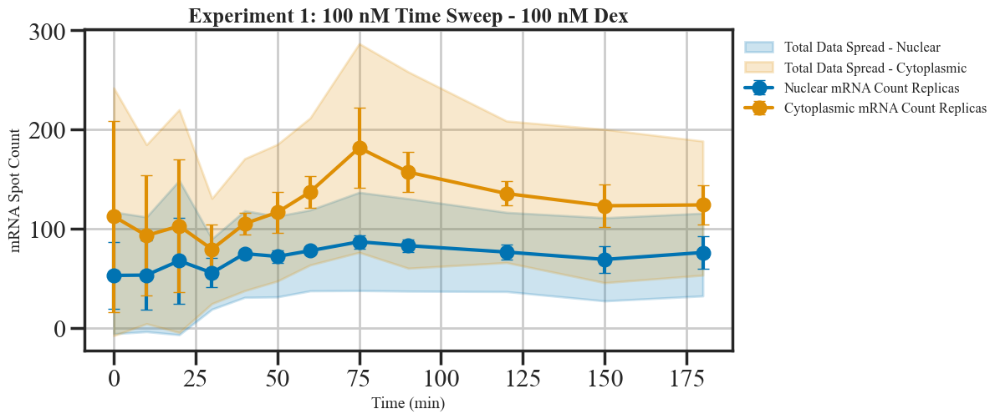

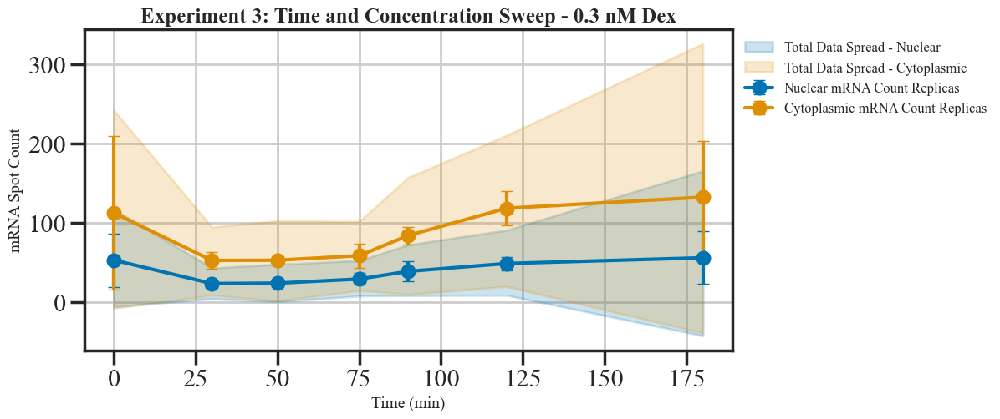

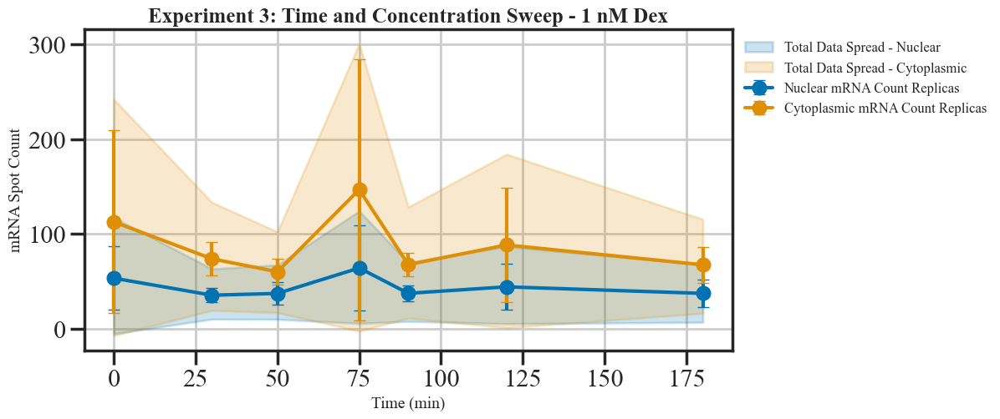

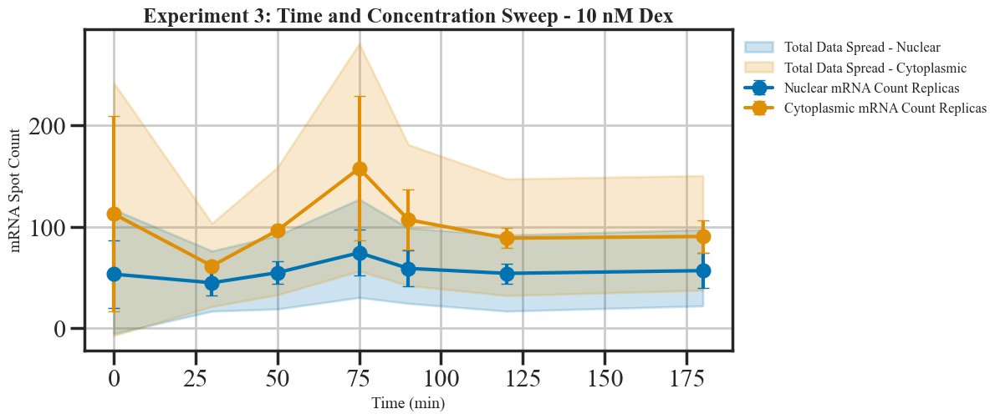

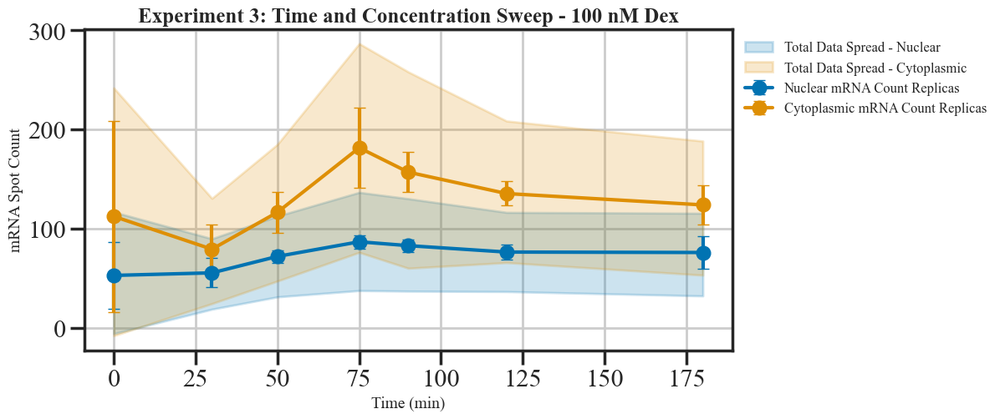

In [ ]:
# Make a copy of the DUSP1 data
DUSP1_data = df_dusp_gated.copy()

# Experiment 1: 100 nM Dex time sweep with 12 timepoints
df_expt1 = DUSP1_data[DUSP1_data['replica'].isin(['D', 'E', 'F', 'M', 'N'])]
expt1_timepoints = [10, 20, 30, 40, 50, 60, 75, 90, 120, 150, 180]
expt1_concs = [100]

# Experiment 3: Time and concentration sweep
df_expt3 = DUSP1_data[DUSP1_data['replica'].isin(['J', 'K', 'L'])]
expt3_concs = [0.3, 1, 10, 100]
expt3_timepoints = [30, 50, 75, 90, 120, 180]

# Calculate means for each replica
replica_means = DUSP1_data.groupby(['dex_conc', 'time', 'replica']).agg({
    'num_nuc_spots': 'mean',
    'num_cyto_spots': 'mean'
}).reset_index()

# Calculate the mean and standard deviation of the replica means
summary_stats = replica_means.groupby(['dex_conc', 'time']).agg({
    'num_nuc_spots': ['mean', 'std'],
    'num_cyto_spots': ['mean', 'std']
}).reset_index()

# Rename columns for easier access
summary_stats.columns = ['dex_conc', 'time', 'mean_nuc_count', 'std_nuc_count', 'mean_cyto_count', 'std_cyto_count']

# Calculate overall mean and standard deviation for each concentration and time point
overall_stats = DUSP1_data.groupby(['dex_conc', 'time']).agg({
    'num_nuc_spots': ['mean', 'std'],
    'num_cyto_spots': ['mean', 'std']
}).reset_index()

# Rename columns for easier access
overall_stats.columns = ['dex_conc', 'time', 'overall_mean_nuc', 'overall_std_nuc', 'overall_mean_cyto', 'overall_std_cyto']

# Extract 0 min data (shared baseline from dex_conc == 0)
zero_min_summary = summary_stats[summary_stats['time'] == 0]
zero_min_overall = overall_stats[overall_stats['time'] == 0]

# Set Style
sns.set_theme(style="ticks", palette="colorblind", context="poster", font='times new roman')

# Define the color palette for Nuclear and Cytoplasmic intensities
colors_nuc_cyto = sns.color_palette("colorblind", 2)  # Two colors: one for Nuclear, one for Cytoplasmic

# Loop through the three experiments
experiments = {
    "Experiment 1: 100 nM Time Sweep": (expt1_concs, expt1_timepoints),
    # "Experiment 2: 75 min Concentration Sweep": (expt2_concs, expt2_timepoints),
    "Experiment 3: Time and Concentration Sweep": (expt3_concs, expt3_timepoints),
}

for expt_name, (concs, timepoints) in experiments.items():
    for conc in concs:
        # Filter data for plotting
        subset_summary = summary_stats[(summary_stats['dex_conc'] == conc) & (summary_stats['time'].isin(timepoints))]
        subset_overall = overall_stats[(overall_stats['dex_conc'] == conc) & (overall_stats['time'].isin(timepoints))]

        # Add 0 min time point to all subsets if not already present
        if 0 not in subset_summary['time'].values:
            subset_summary = pd.concat([zero_min_summary, subset_summary], ignore_index=True)
        if 0 not in subset_overall['time'].values:
            subset_overall = pd.concat([zero_min_overall, subset_overall], ignore_index=True)

        plt.figure(figsize=(10, 5))

        # Plot Nuclear mRNA Count Mean with Error Bars
        plt.errorbar(subset_summary['time'], subset_summary['mean_nuc_count'],
                     yerr=subset_summary['std_nuc_count'], fmt='-o', color=colors_nuc_cyto[0], capsize=5,
                     label='Nuclear mRNA Count Replicas')

        # Filling between std deviations for overall data - Nuclear
        plt.fill_between(subset_overall['time'],
                         subset_overall['overall_mean_nuc'] - subset_overall['overall_std_nuc'],
                         subset_overall['overall_mean_nuc'] + subset_overall['overall_std_nuc'],
                         color=colors_nuc_cyto[0], alpha=0.2, label='Total Data Spread - Nuclear')

        # Plot Cytoplasmic mRNA Count Mean with Error Bars
        plt.errorbar(subset_summary['time'], subset_summary['mean_cyto_count'],
                     yerr=subset_summary['std_cyto_count'], fmt='-o', color=colors_nuc_cyto[1], capsize=5,
                     label='Cytoplasmic mRNA Count Replicas')

        # Filling between std deviations for overall data - Cytoplasmic
        plt.fill_between(subset_overall['time'],
                         subset_overall['overall_mean_cyto'] - subset_overall['overall_std_cyto'],
                         subset_overall['overall_mean_cyto'] + subset_overall['overall_std_cyto'],
                         color=colors_nuc_cyto[1], alpha=0.2, label='Total Data Spread - Cytoplasmic')

        # Customize the plot
        plt.title(f"{expt_name} - {conc} nM Dex", fontsize=18, fontweight='bold')
        plt.xlabel('Time (min)', fontsize=14)
        plt.ylabel('mRNA Spot Count', fontsize=14)
        plt.grid(True)
        plt.legend(loc='upper left', fontsize=12, frameon=False, bbox_to_anchor=(1, 1))


        # Show the plot
        plt.show()


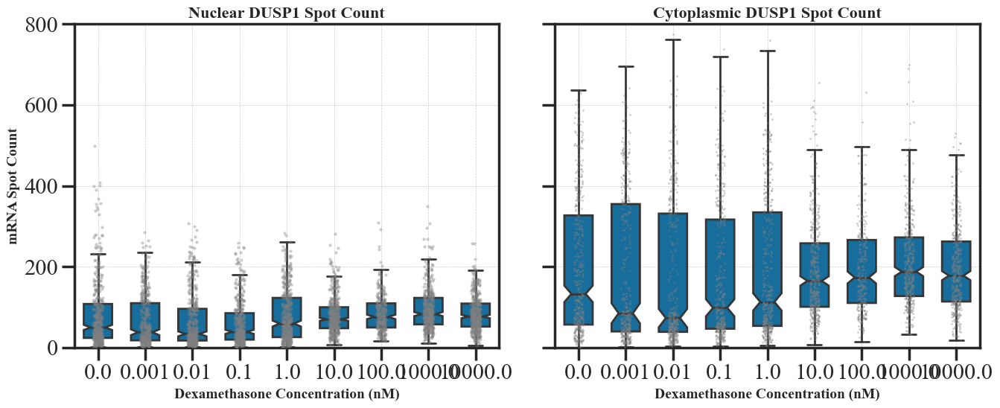

In [44]:
# Make a copy of the DUSP1 data
DUSP1_data = df_dusp_gated.copy()

# Experiment 2: 75 min concentration sweep (Replicas G, H, I)
df_expt2 = DUSP1_data[DUSP1_data['replica'].isin(['G', 'H', 'I'])].copy()

# Set Seaborn style
sns.set_theme(style="ticks", palette="colorblind", context="poster", font='times new roman')

# Melt DataFrame for Seaborn Box Plot
melted_expt2_data = df_expt2.melt(id_vars=['dex_conc'], value_vars=['num_nuc_spots', 'num_cyto_spots'],
                                  var_name='Spot_Type', value_name='Spot_Count')

# Update labels for readability
melted_expt2_data['Spot_Type'] = melted_expt2_data['Spot_Type'].replace({
    'num_nuc_spots': 'Nuclear Spots',
    'num_cyto_spots': 'Cytoplasmic Spots'
})

# Create figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

# Nuclear Spots Plot
ax1 = axes[0]
nuc_data = melted_expt2_data[melted_expt2_data['Spot_Type'] == 'Nuclear Spots']
sns.boxplot(x='dex_conc', y='Spot_Count', data=nuc_data, linewidth=2, width=0.6, showfliers=False, notch=True, ax=ax1)
sns.stripplot(x='dex_conc', y='Spot_Count', data=nuc_data, dodge=True, jitter=True, size=3, alpha=0.4, ax=ax1, marker='o', edgecolor='black', color='gray')

ax1.set_xlabel("Dexamethasone Concentration (nM)", fontsize=14, fontweight='bold')
ax1.set_ylabel("mRNA Spot Count", fontsize=14, fontweight='bold')
ax1.set_title("Nuclear DUSP1 Spot Count", fontsize=16, fontweight='bold')
ax1.grid(True, linestyle="--", linewidth=0.5)

# Cytoplasmic Spots Plot
ax2 = axes[1]
cyto_data = melted_expt2_data[melted_expt2_data['Spot_Type'] == 'Cytoplasmic Spots']
sns.boxplot(x='dex_conc', y='Spot_Count', data=cyto_data, linewidth=2, width=0.6, showfliers=False, notch=True, ax=ax2)
sns.stripplot(x='dex_conc', y='Spot_Count', data=cyto_data, dodge=True, jitter=True, size=2, alpha=0.4, ax=ax2, marker='o', edgecolor='black', color='gray')

ax2.set_xlabel("Dexamethasone Concentration (nM)", fontsize=14, fontweight='bold')
ax2.set_ylabel("")  # Remove redundant label
ax2.set_title("Cytoplasmic DUSP1 Spot Count", fontsize=16, fontweight='bold')
ax2.grid(True, linestyle="--", linewidth=0.5)

# Set Y-limits 
ax1.set_ylim(0, 300)
ax2.set_ylim(0, 800)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


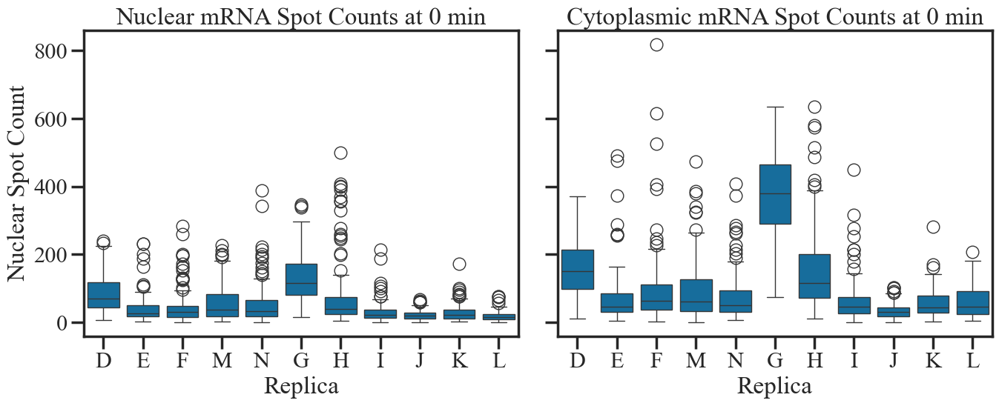

In [47]:
## Cytoplasmic and Nuclear mRNA Spot Counts at 0 min

# Make a copy of the DUSP1 data
DUSP1_data = df_dusp_gated.copy()

# Subset data for 0 min time points
df_0min = DUSP1_data[DUSP1_data['time'] == 0]

# Plot distribution of nuclear and cytoplasmic mRNA spots across replicas for 0 min time point
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

sns.boxplot(data=df_0min, x='replica', y='num_nuc_spots', ax=axes[0])
axes[0].set_title('Nuclear mRNA Spot Counts at 0 min')
axes[0].set_ylabel('Nuclear Spot Count')
axes[0].set_xlabel('Replica')

sns.boxplot(data=df_0min, x='replica', y='num_cyto_spots', ax=axes[1])
axes[1].set_title('Cytoplasmic mRNA Spot Counts at 0 min')
axes[1].set_ylabel('Cytoplasmic Spot Count')
axes[1].set_xlabel('Replica')

plt.tight_layout()
plt.show()